In [3]:
from sklearn.datasets import make_blobs
import numpy as np

# Parameters
n_features = 4  # Number of features
n_samples = 1000  # Samples per class
centers = [[1, 1, 1, 1], [-1, -1, -1, -1]]  # Fixed centers
cluster_std = [0.5, 0.8]  # Anisotropic scaling

# Generate anisotropic blobs
X, y = make_blobs(n_samples=n_samples, centers=centers, cluster_std=cluster_std, n_features=n_features, random_state=42)

In [4]:
from scipy.spatial.transform import Rotation as R
import pandas as pd

def rotate_along_x1_fix(data, angle_degrees):
    # Apply rotation to the first 3 features
    rotation = R.from_euler('x', angle_degrees, degrees=True)
    rotated_part = rotation.apply(data[:, :3])
    # Combine rotated part with the unrotated X4 feature
    return np.hstack([rotated_part, data[:, 3].reshape(-1, 1)])

# Generate datasets with corrected rotation
rotated_datasets = {}
angles = [0, 15, 30, 45, 60, 75, 90]

for angle in angles:
    rotated_X = rotate_along_x1_fix(X, angle)
    df = pd.DataFrame(rotated_X, columns=['X1', 'X2', 'X3', 'X4'])
    df['label'] = y
    rotated_datasets[angle] = df

In [57]:
def bootstrap_roc_auc(y_real, y_proba, n_bootstraps=1000, ci=95):
    bootstrapped_scores = []
    rng = np.random.RandomState(42)

    for i in range(n_bootstraps):
        # Бутстрепинг с повторной выборкой
        indices = rng.randint(0, len(y_proba), len(y_proba))
        if len(np.unique(y_real[indices])) < 2:
            continue  # Пропуск, если в выборке только один класс

        fpr, tpr, _ = roc_curve(y_real[indices], y_proba[indices])
        score = auc(fpr, tpr)
        bootstrapped_scores.append(score)
    
    sorted_scores = np.sort(bootstrapped_scores)
    lower_bound = np.percentile(sorted_scores, (100 - ci) / 2)
    upper_bound = np.percentile(sorted_scores, 100 - (100 - ci) / 2)
    
    return lower_bound, upper_bound

In [69]:
def plot_roc_ci(df, name, feature_pair, ax, n_bootstraps=1000, ci=95, tc='label'):
    y_real = []
    y_proba = []
    precision_array = []
    roc_tpr_array = []
    roc_fpr_array = np.linspace(0, 1, 100)  # Array of FPR values for ROC
    X = df.drop(columns=tc).values
    y = df[tc].values

    skf = StratifiedKFold(n_splits=5)
    for i, (train_index, test_index) in enumerate(skf.split(X, y)):
        Xtrain, Xtest = X[train_index], X[test_index]
        ytrain, ytest = y[train_index], y[test_index]
        
        predictor = GaussianNB()
        predictor.fit(Xtrain, ytrain)
        pred_proba = predictor.predict_proba(Xtest)
    
        # ROC curve for each fold
        fpr_fold, tpr_fold, thresholds_fold = roc_curve(ytest, pred_proba[:, 1])
        roc_auc = auc(fpr_fold, tpr_fold)
        roc_tpr_interp = np.interp(roc_fpr_array, fpr_fold, tpr_fold)
        roc_tpr_array.append(roc_tpr_interp)
    
        ax.plot(fpr_fold, tpr_fold, alpha=0.3) # , label=lab_fold_roc
     
        # Collect all real values and predicted probabilities for bootstrapping
        y_real.append(ytest)
        y_proba.append(pred_proba[:, 1])
    
    # Concatenate real values and probabilities for overall calculation
    y_real = np.concatenate(y_real)
    y_proba = np.concatenate(y_proba)
    
    # Overall ROC curve
    fpr, tpr, thresholds = roc_curve(y_real, y_proba)
    ax.plot(fpr, tpr, lw=2, color='red', label=f'Overall AUROC={auc(fpr, tpr):.4f}')
    
    # Calculate confidence interval CI95 for the overall ROC curve
    lower_ci_roc, upper_ci_roc = bootstrap_roc_auc(y_real, y_proba, n_bootstraps=n_bootstraps, ci=ci)
    mean_tpr = np.mean(roc_tpr_array, axis=0)
    std_tpr = np.std(roc_tpr_array, axis=0)
    
    # Calculate lower and upper confidence interval bounds for ROC
    ci_lower_roc, ci_upper_roc = mean_tpr - std_tpr, mean_tpr + std_tpr
    ax.fill_between(roc_fpr_array, ci_lower_roc, ci_upper_roc, alpha=0.2, color='grey', label=f'95% CI [{lower_ci_roc:.4f}, {upper_ci_roc:.4f}]')
    
    # Find the closest point on the ROC curve to threshold = 0.5
    threshold_idx = np.argmin(np.abs(thresholds - 0.5))
    fpr_0_5 = fpr[threshold_idx]
    tpr_0_5 = tpr[threshold_idx]
    
    # Add point for threshold = 0.5
    ax.plot(fpr_0_5, tpr_0_5, 'o', markersize=8, label="Threshold", color='blue')
    ax.legend(loc='lower right', fontsize='small')
    ax.set_title(f"ROC curves with CI95 on {name}", weight="bold", fontsize=15)
    ax.set_xlabel("False Positive Rate", fontsize=12)
    ax.set_ylabel("True Positive Rate", fontsize=12)

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


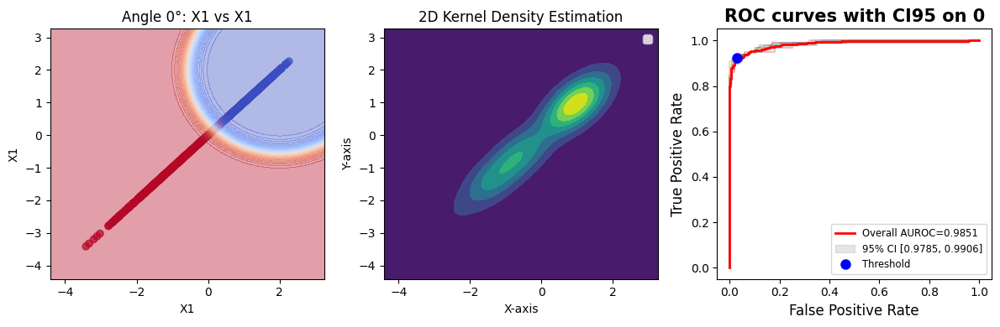

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


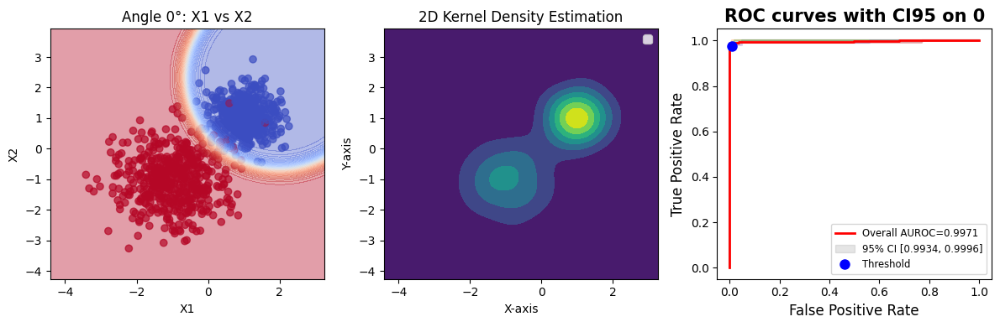

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


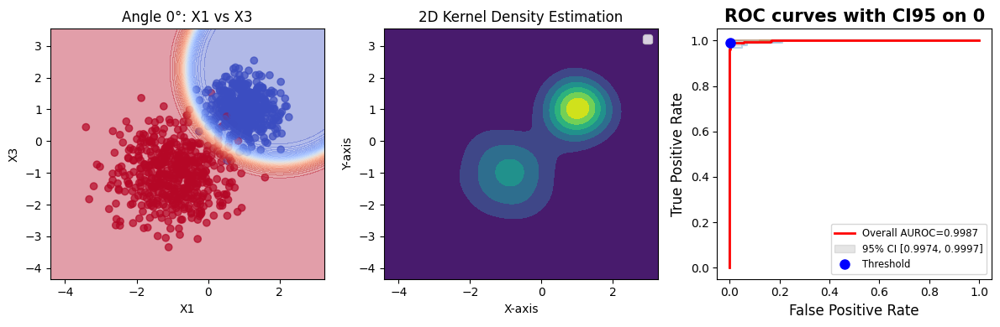

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


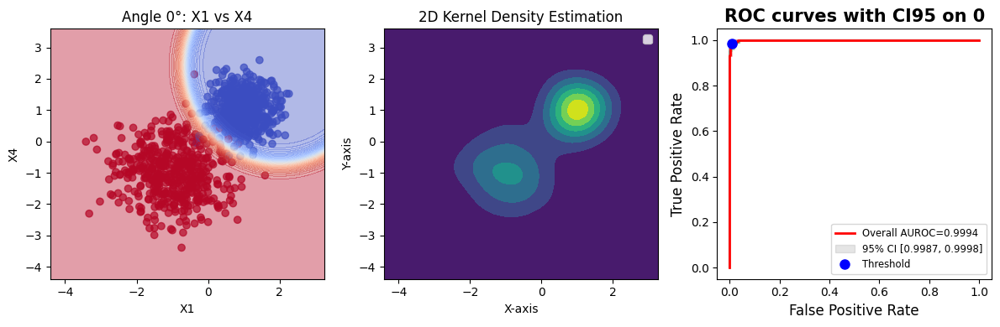

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


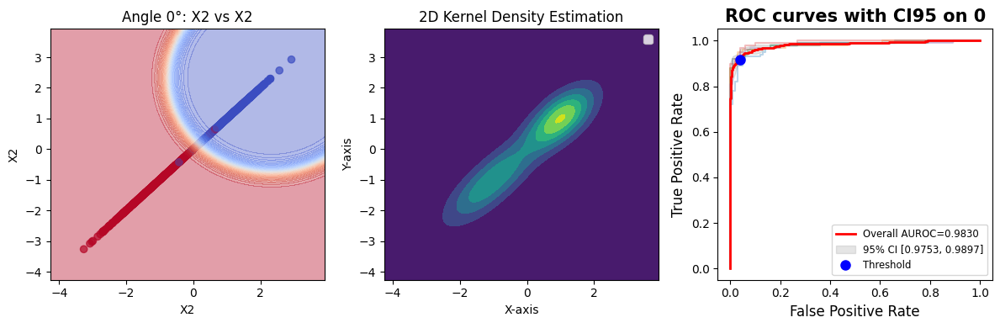

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


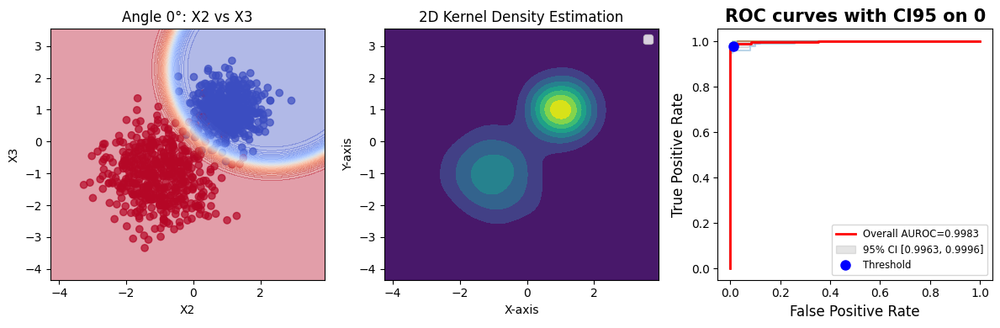

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


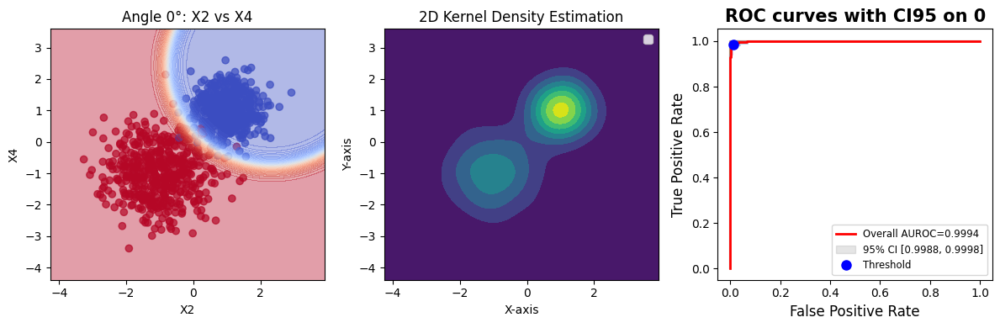

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


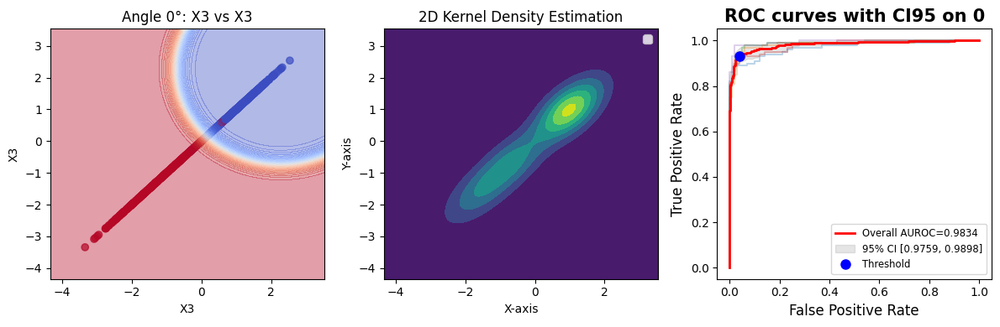

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


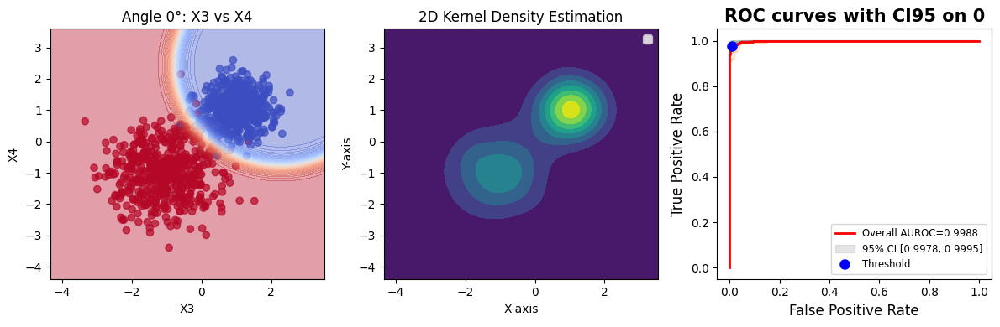

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


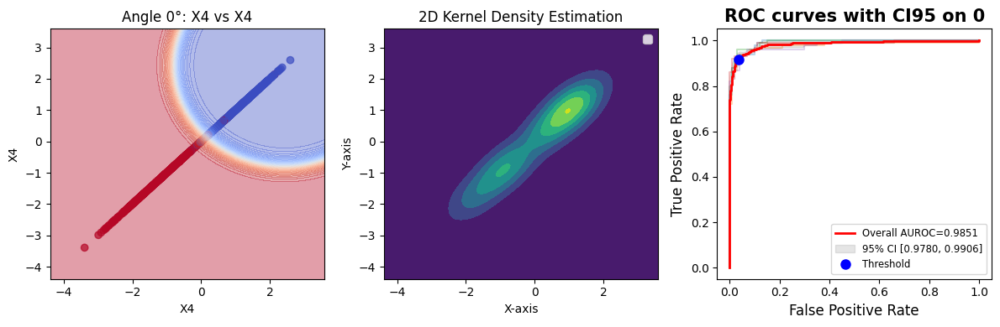

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


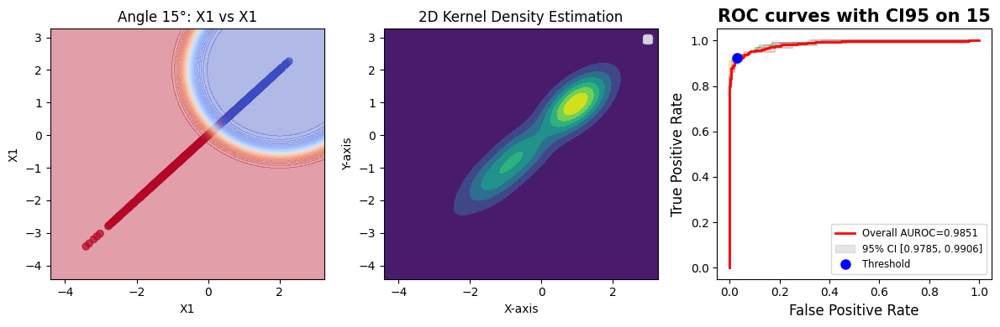

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


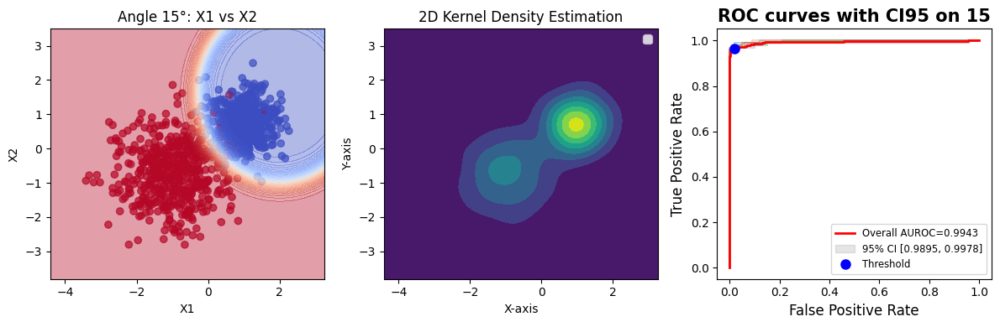

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


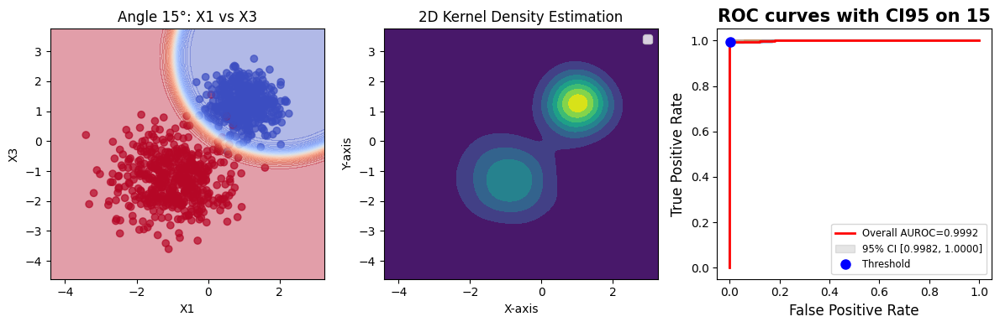

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


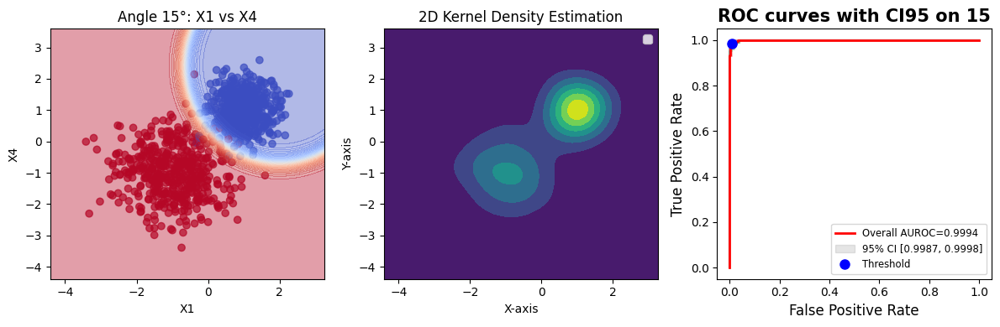

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


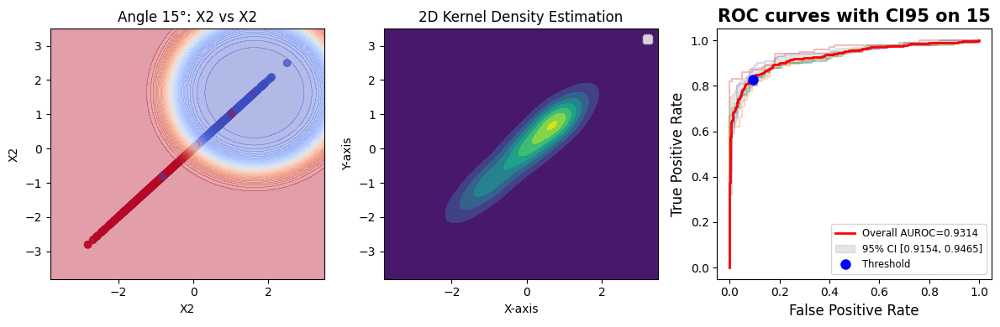

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


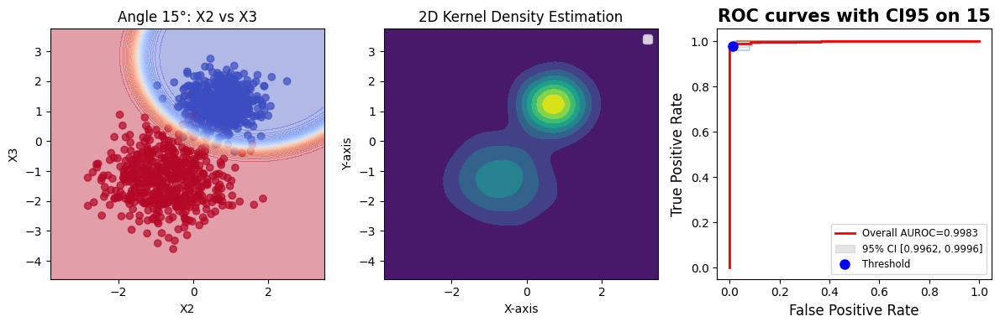

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


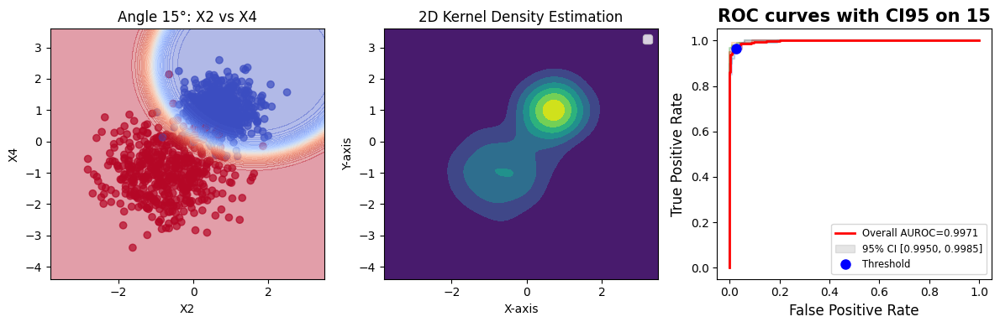

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


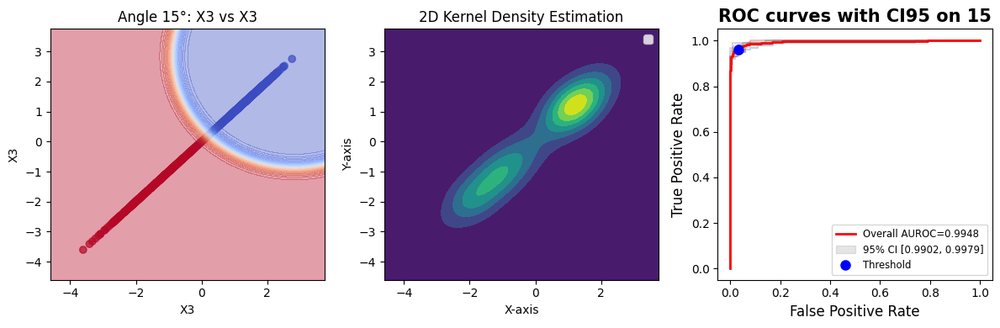

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


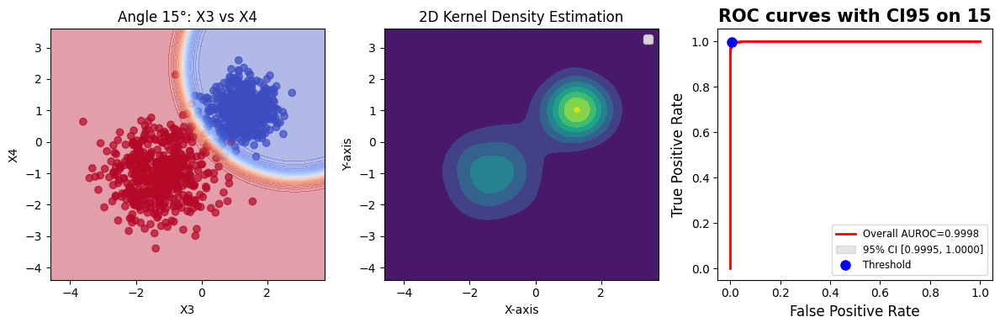

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


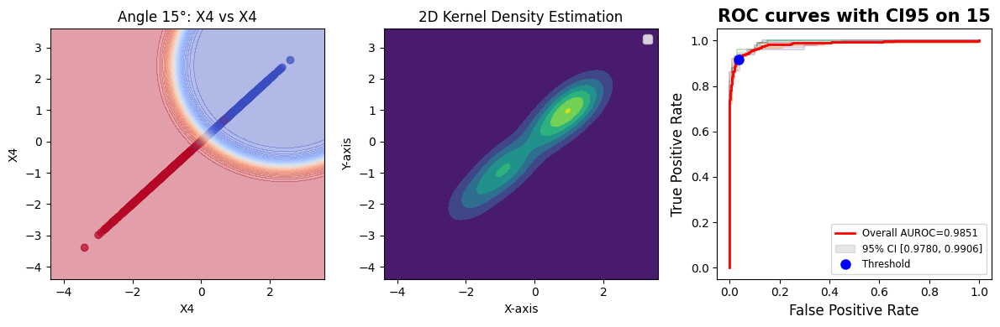

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


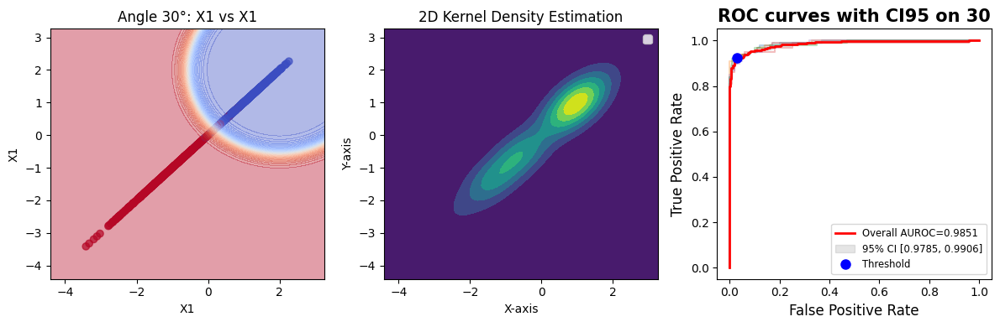

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


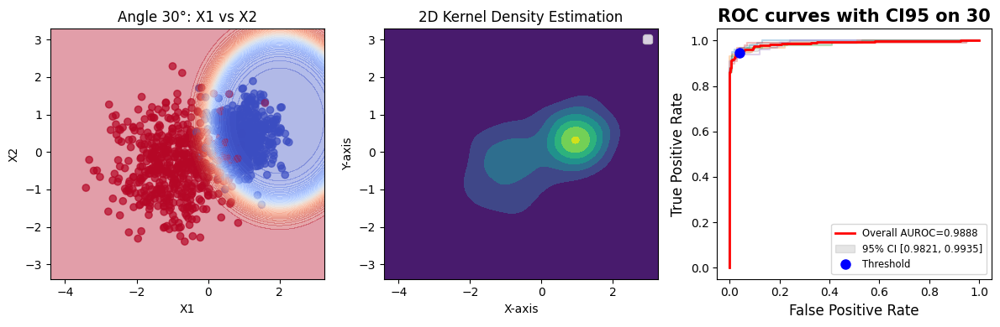

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


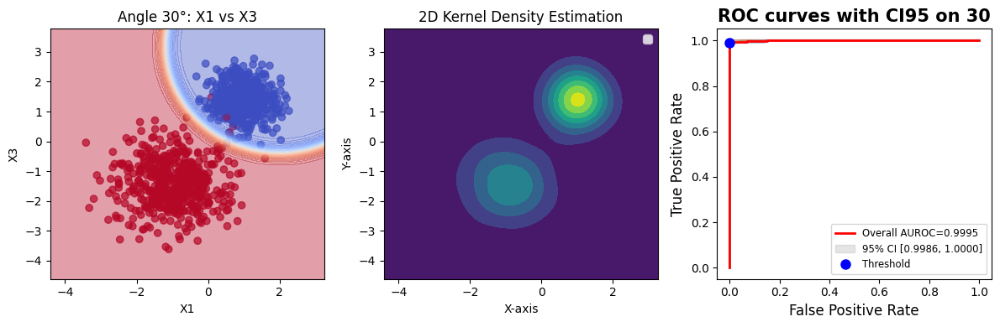

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


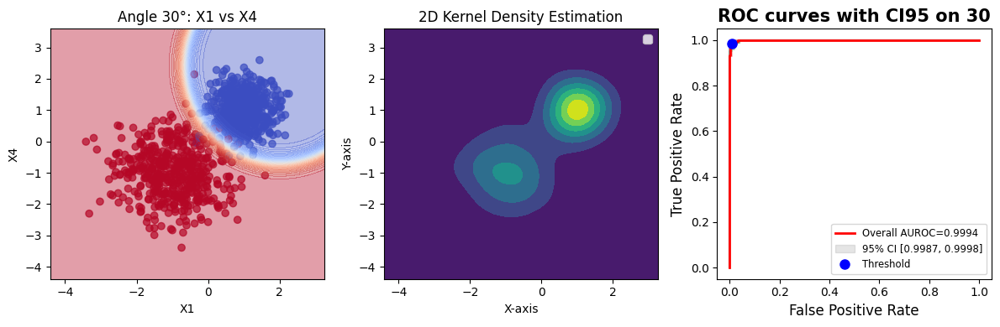

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


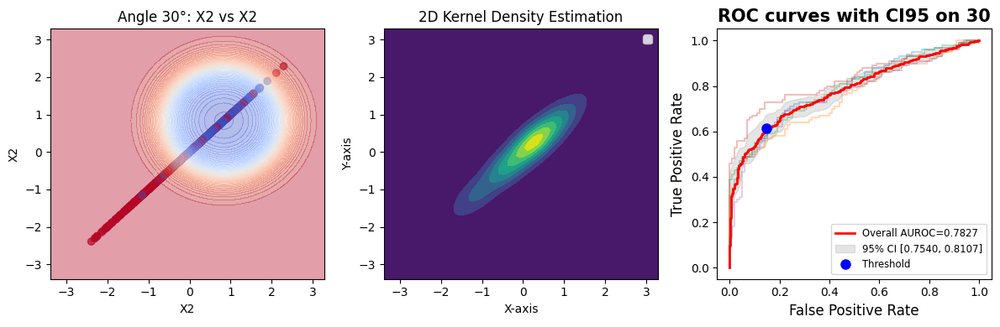

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


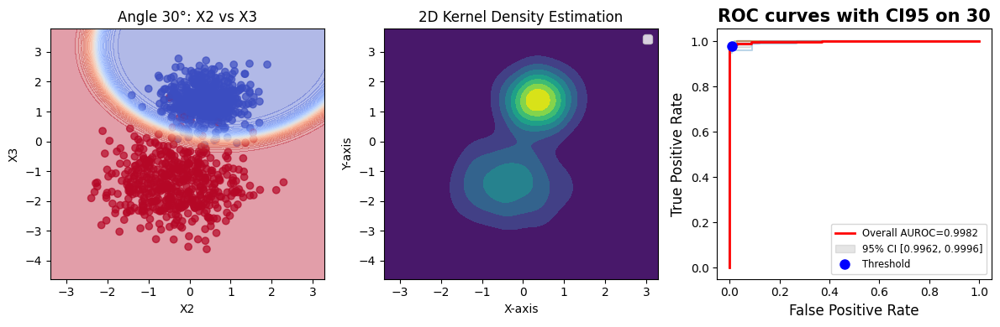

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


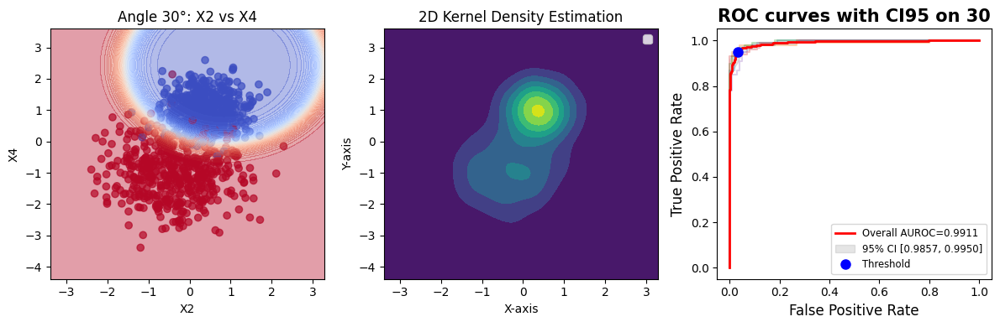

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


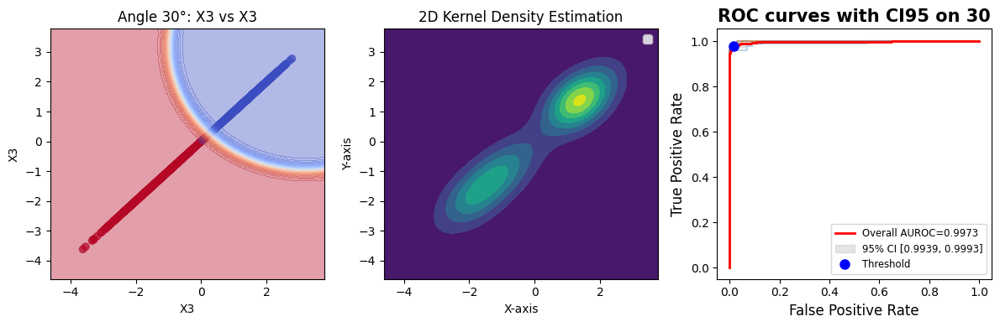

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


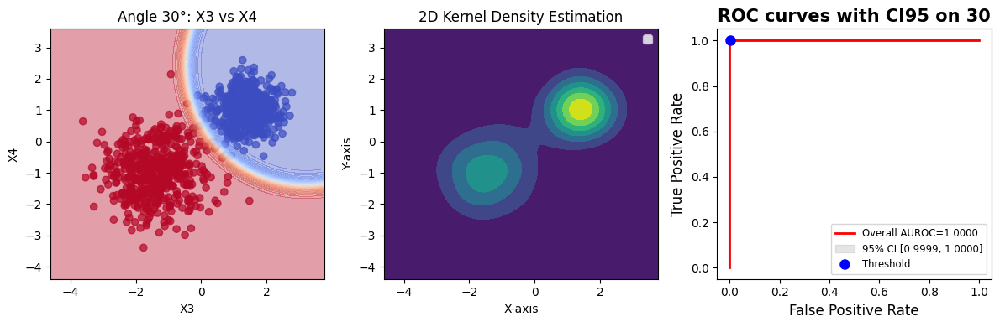

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


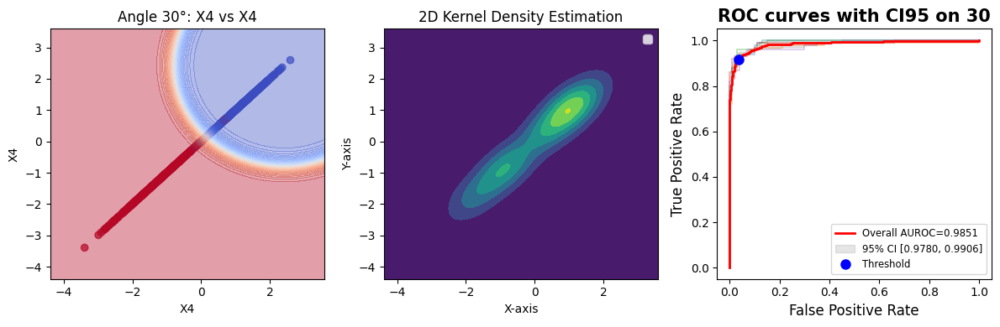

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


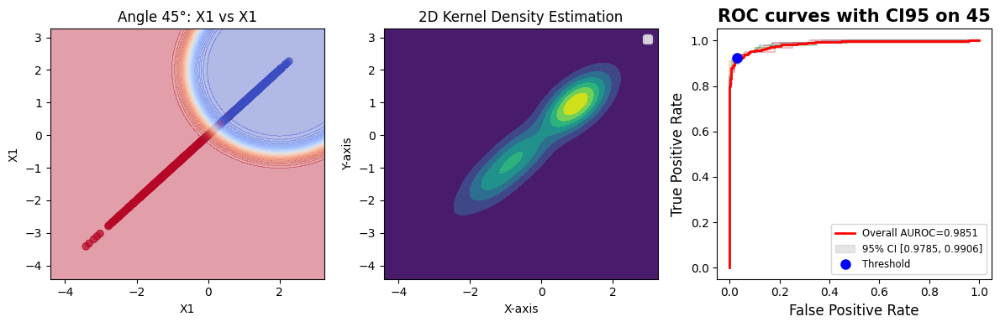

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


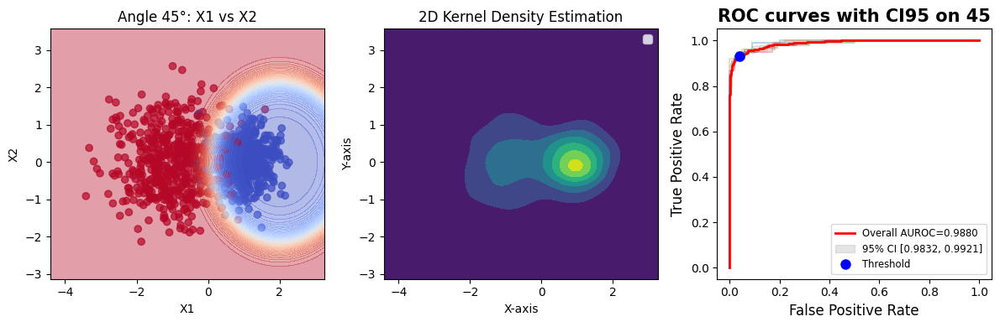

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


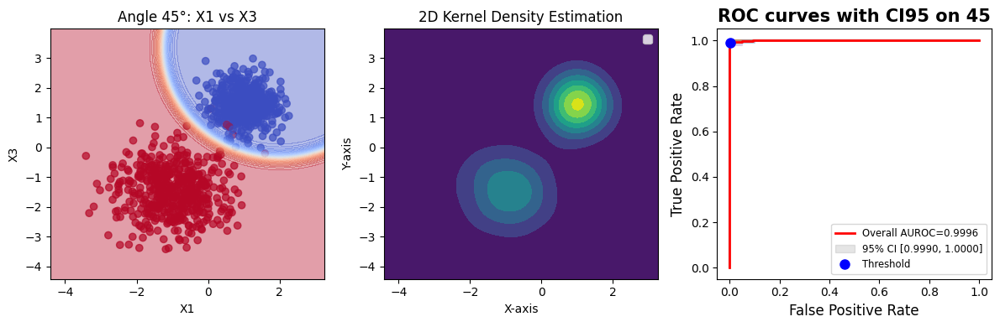

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


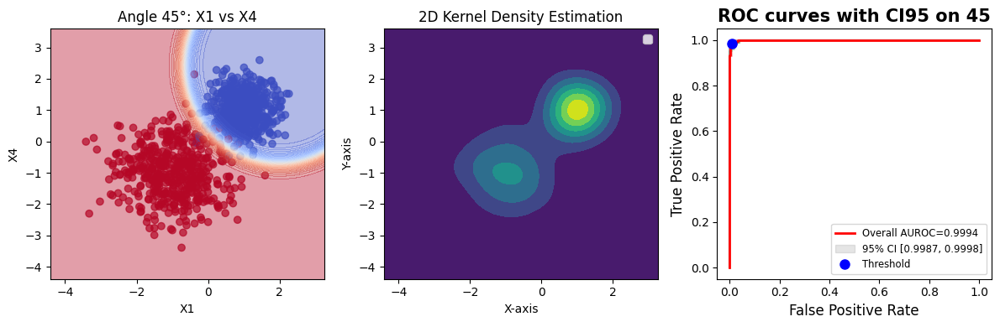

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


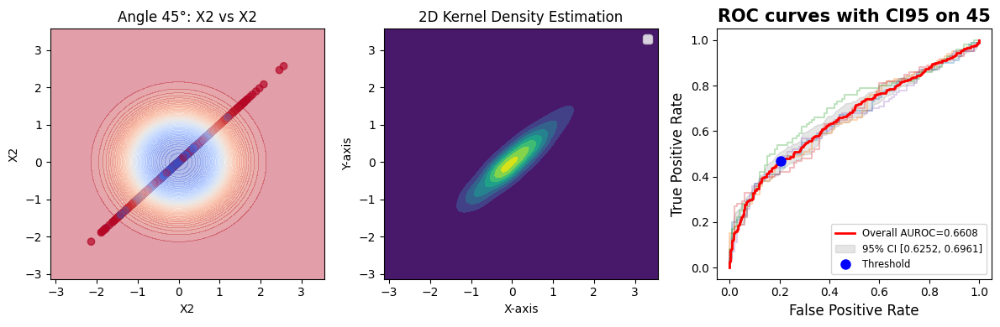

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


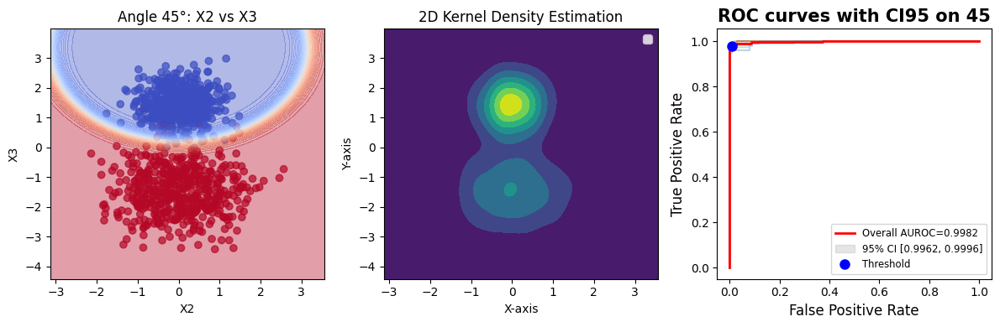

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


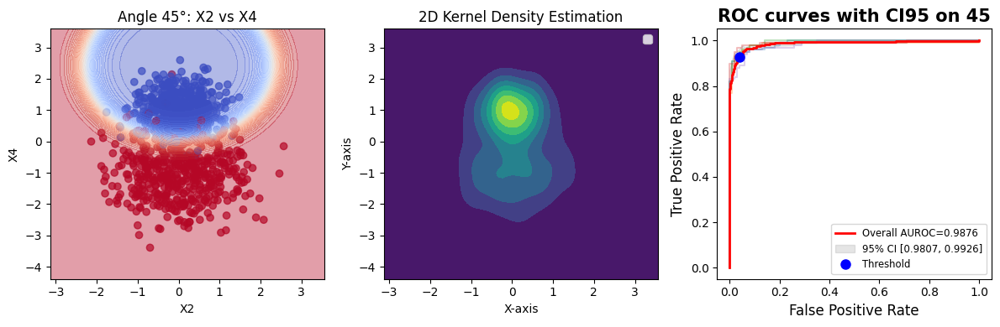

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


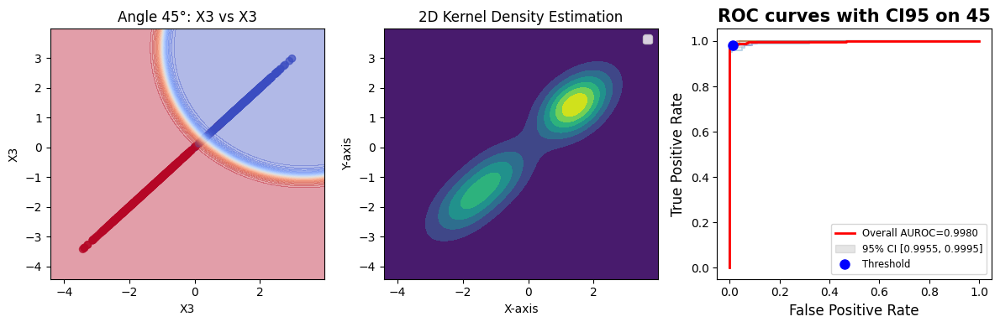

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


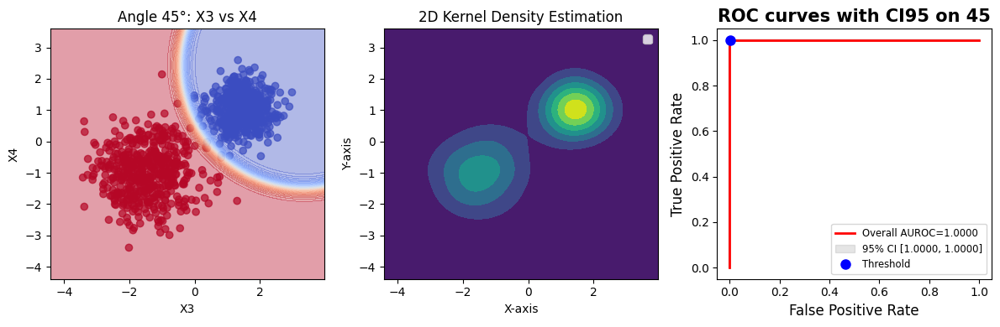

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


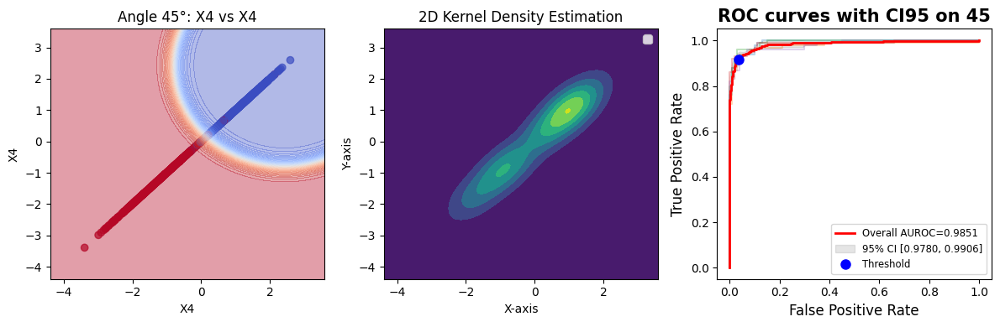

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


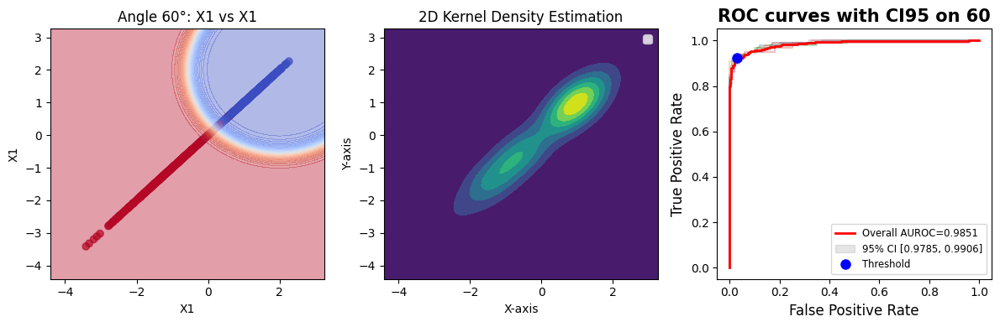

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


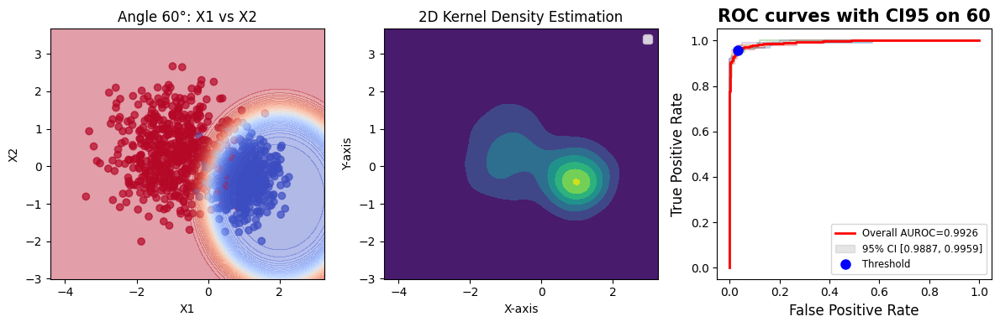

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


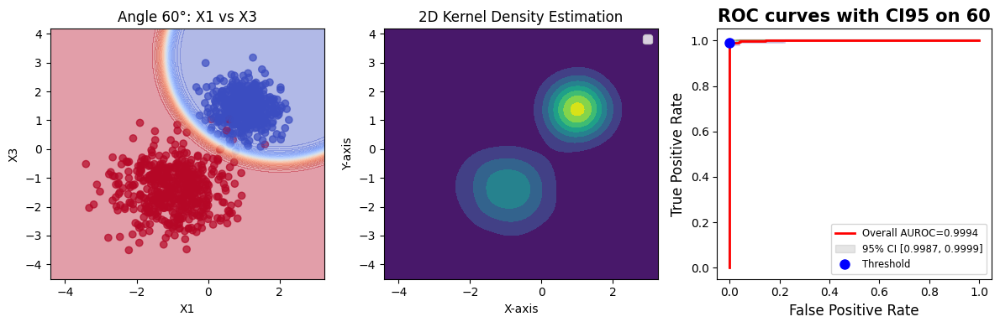

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


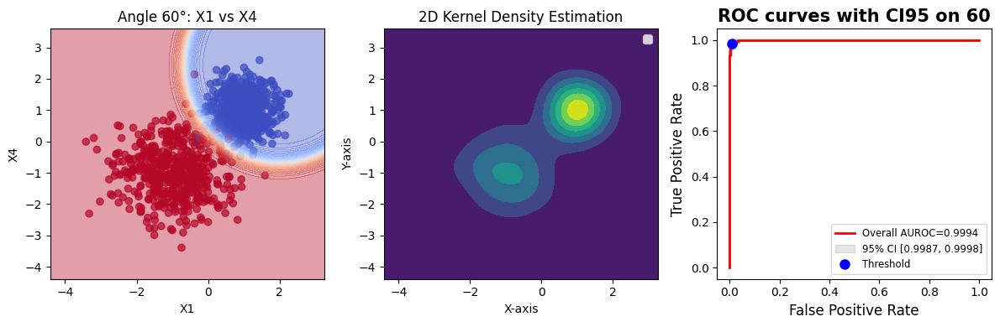

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


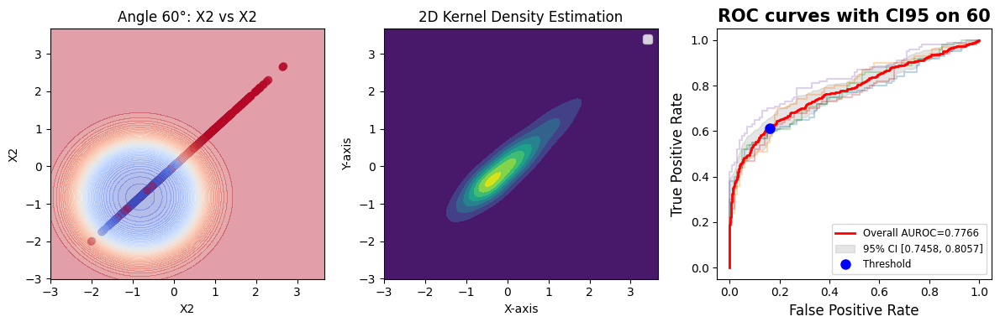

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


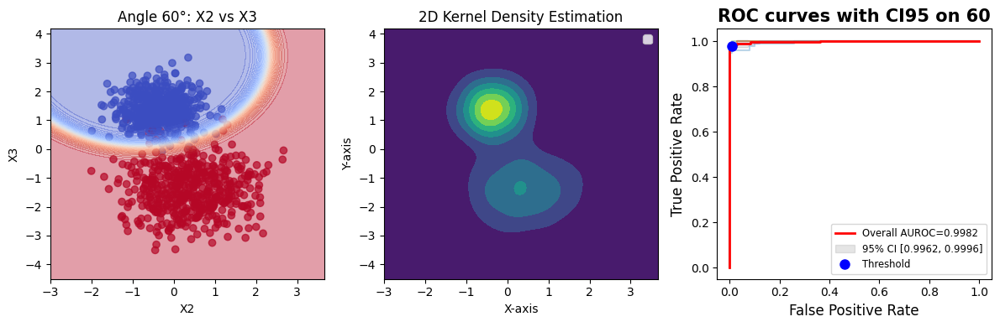

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


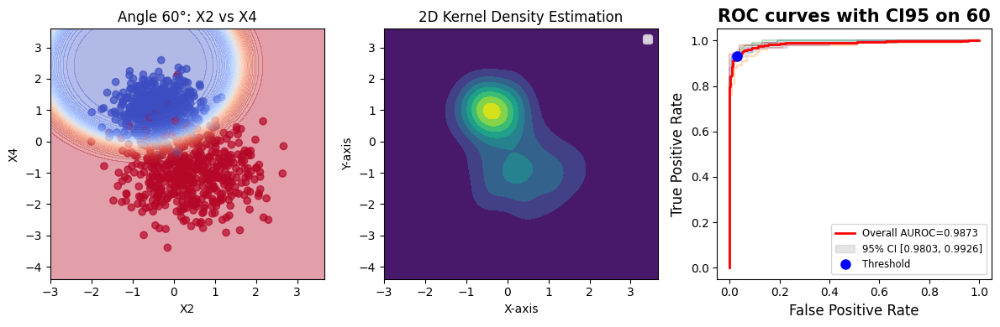

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


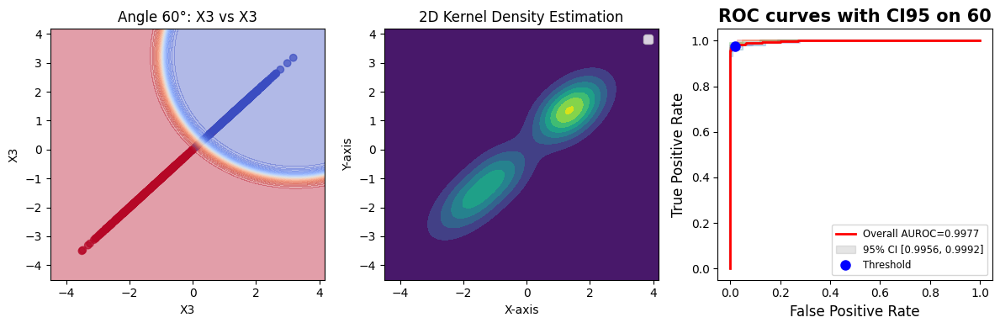

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


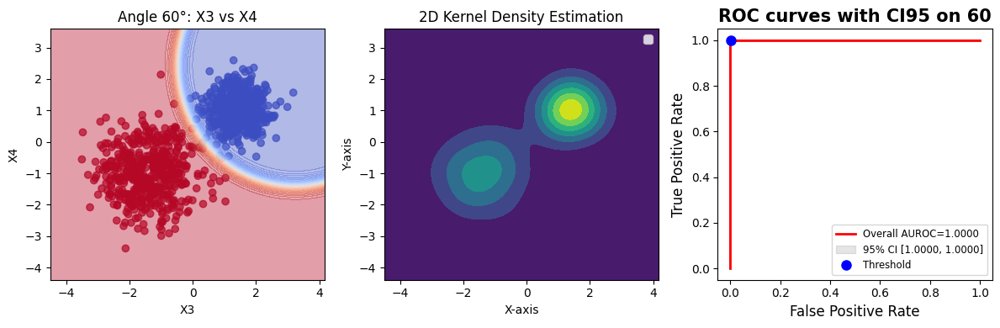

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


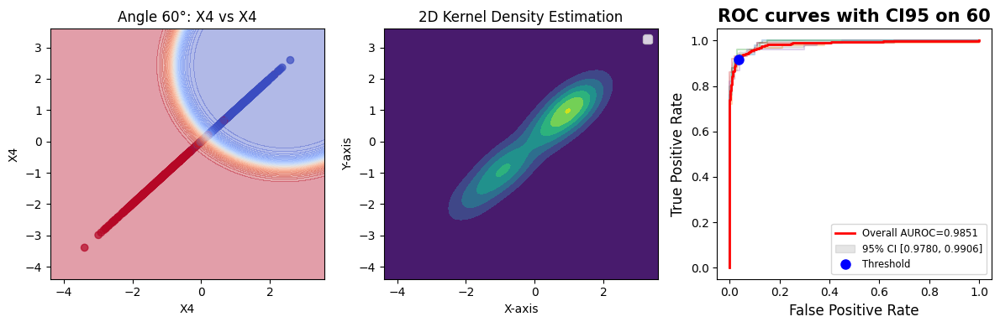

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


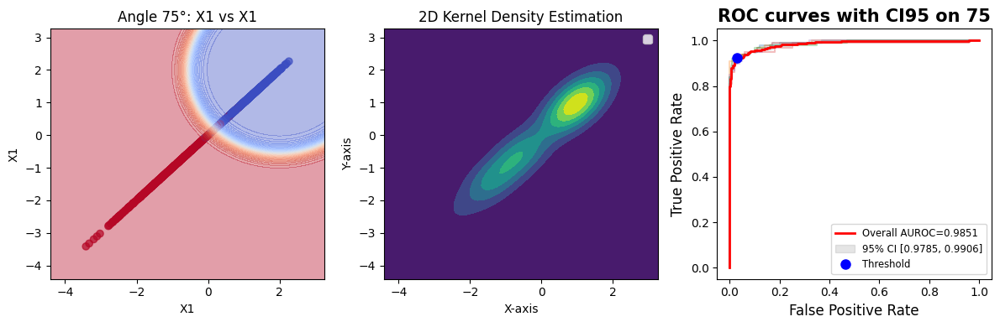

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


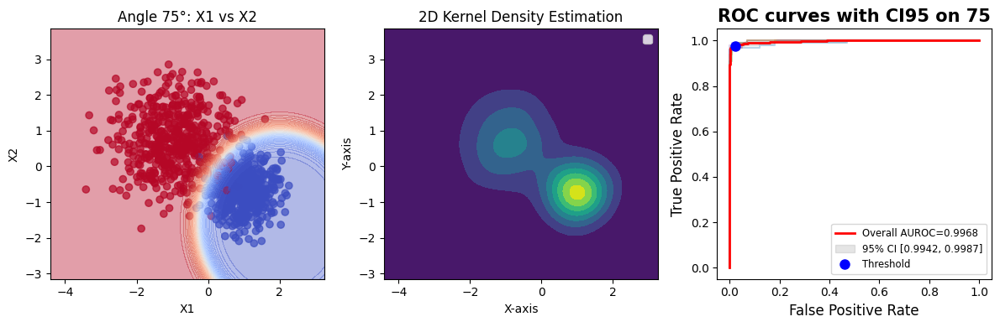

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


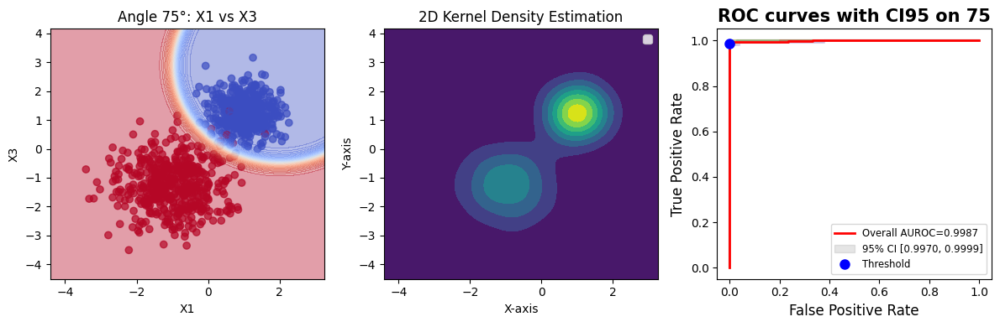

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


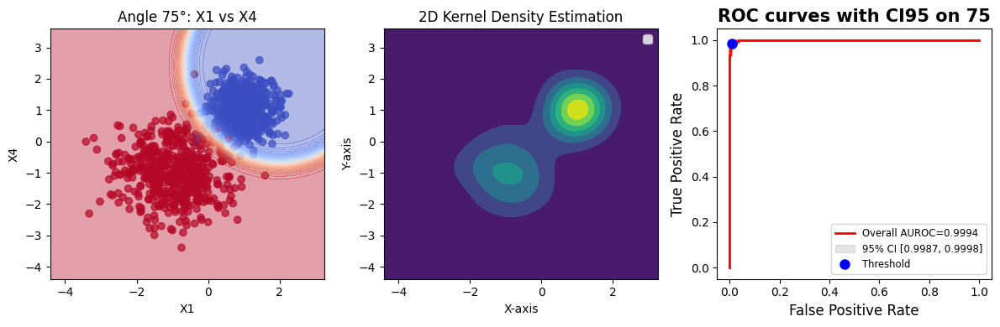

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


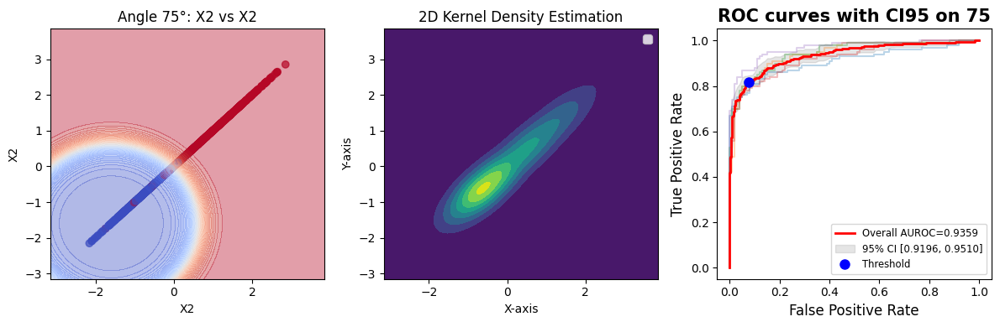

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


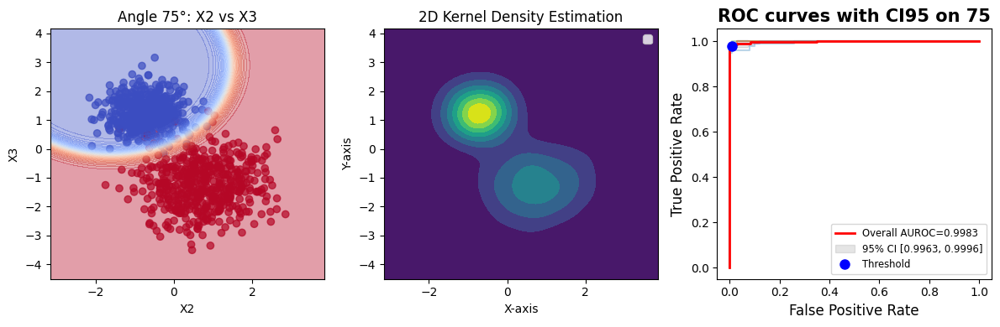

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


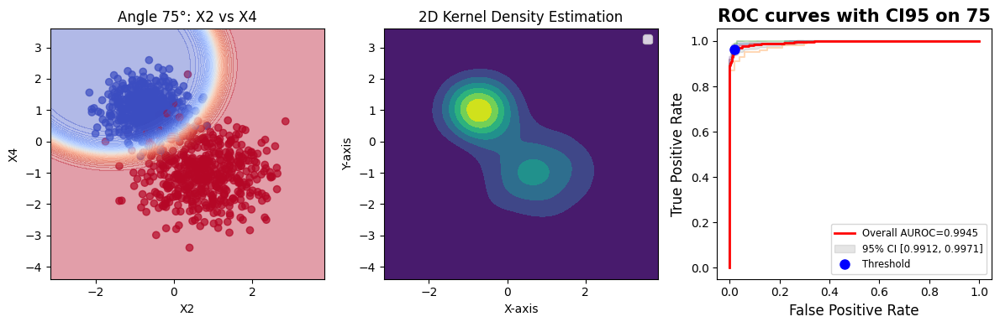

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


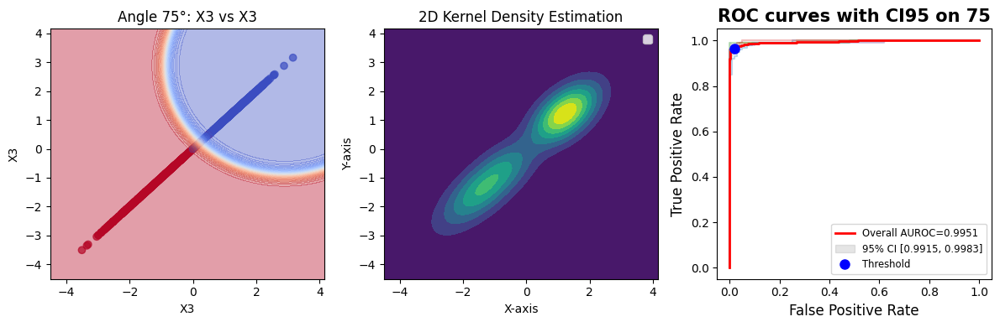

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


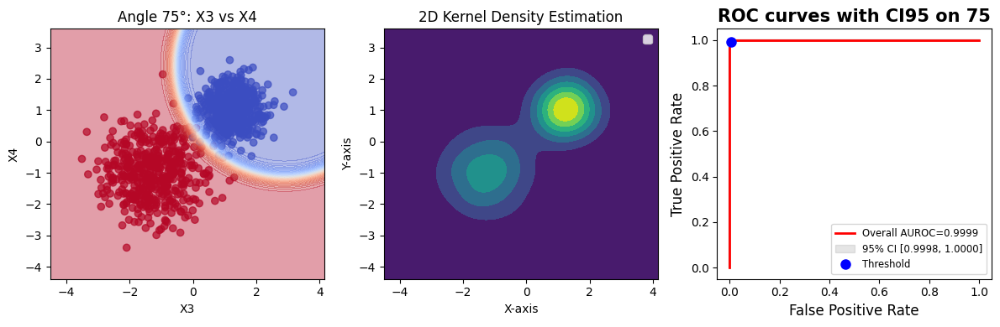

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


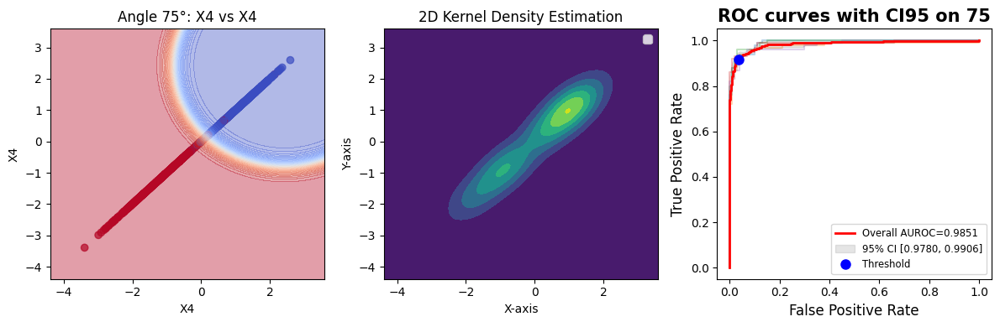

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


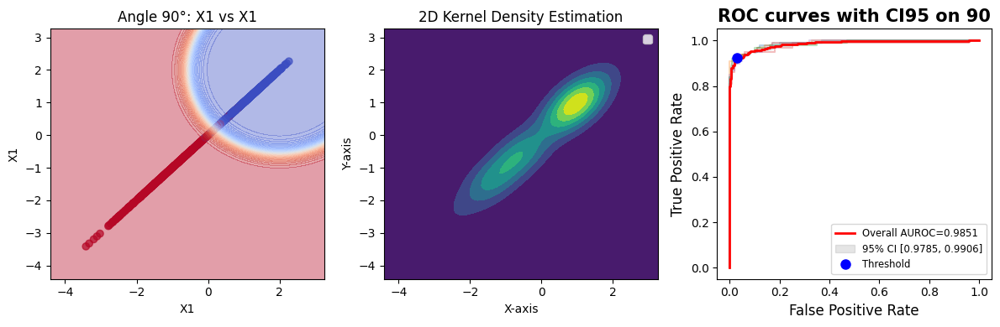

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


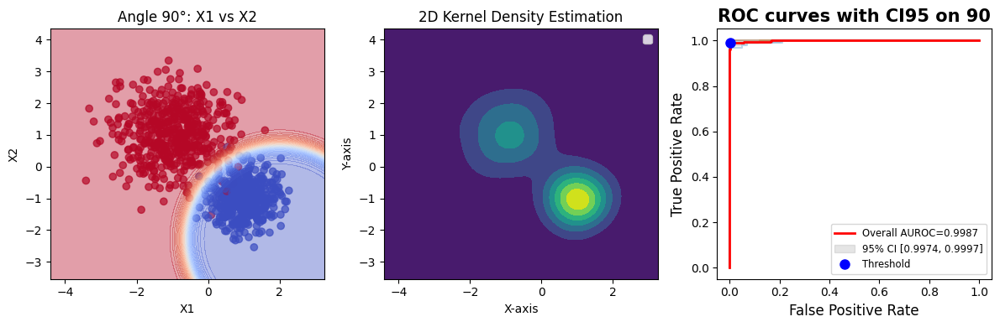

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


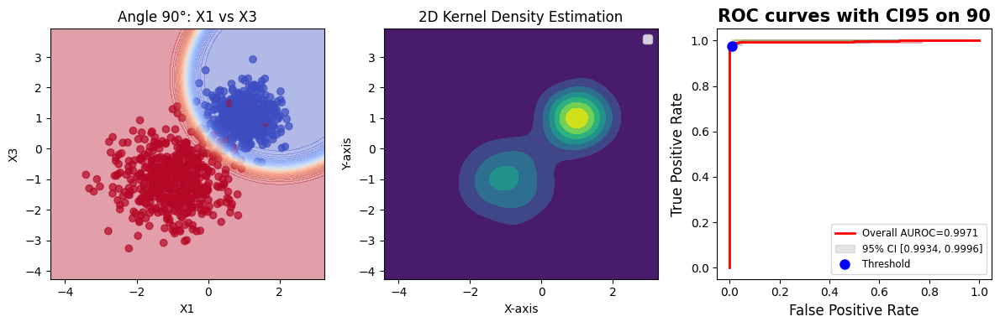

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


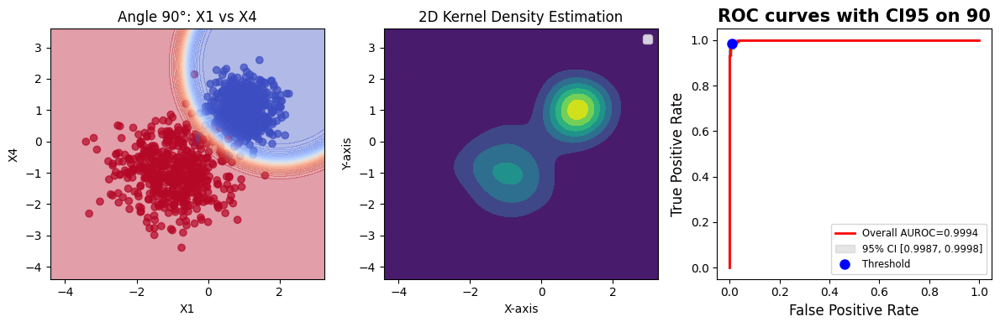

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


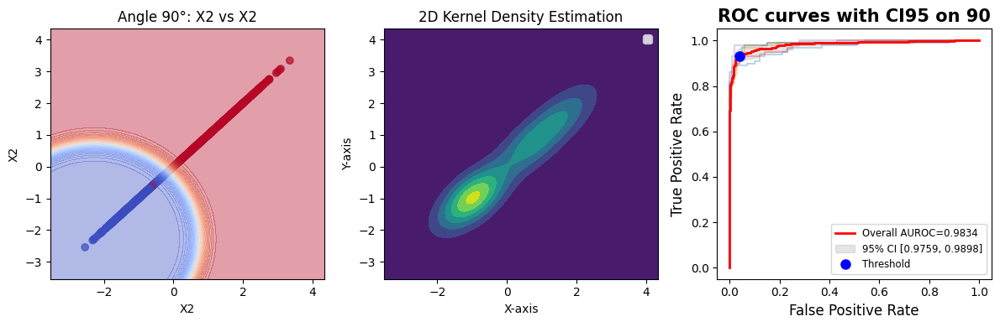

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


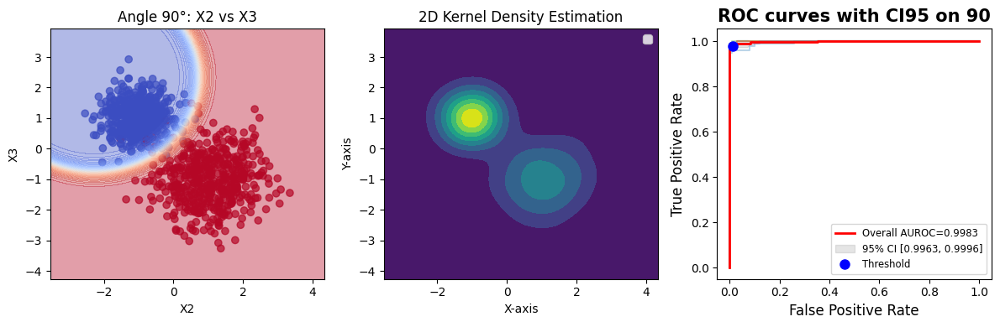

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


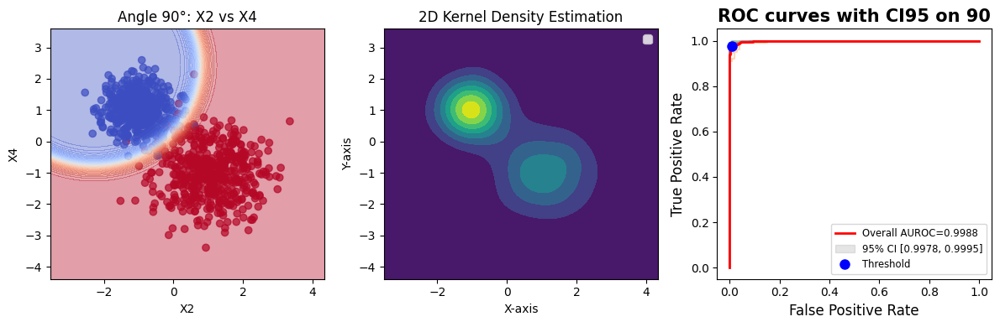

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


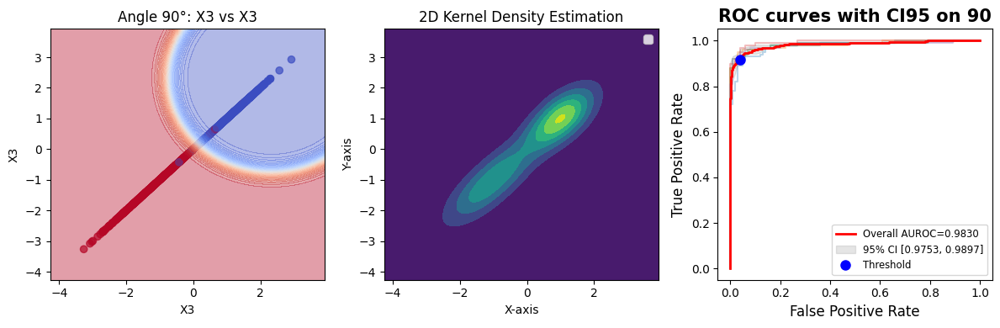

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


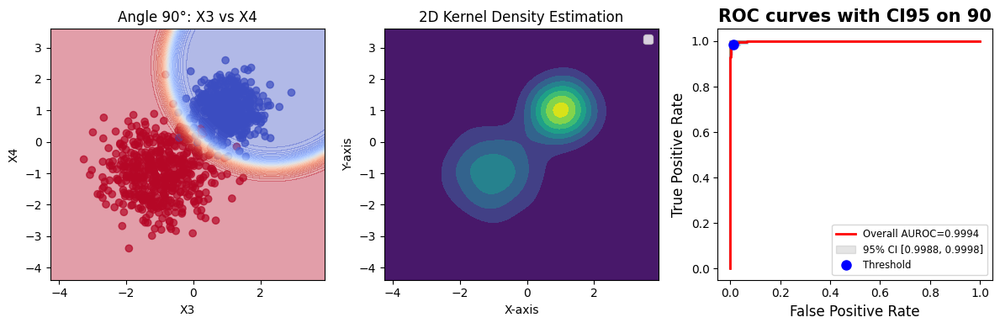

C:\Users\root\AppData\Local\Temp\ipykernel_21324\3422733673.py:47: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax_kde.legend()


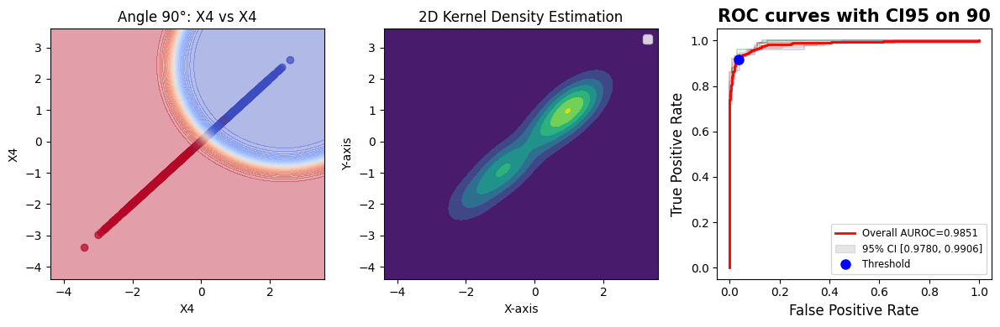

In [59]:
import matplotlib.pyplot as plt
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import roc_curve, auc
from sklearn.utils import resample
import statsmodels.api as sm
import itertools
from  sklearn.model_selection import StratifiedKFold
from scipy.stats import bootstrap

# Function to plot data and decision boundary for a given dataset and feature pair
def plot_decision_boundary(df, feature_pair, angle, ax, ax_kde, tc='label'):
    # Select features and labels
    X_pair = df[list(feature_pair)].values
    y = df[tc].values
    
    # Train Gaussian Naive Bayes classifier
    gnb = GaussianNB()
    gnb.fit(X_pair, y)
    
    # Plot the data points
    scatter = ax.scatter(X_pair[:, 0], X_pair[:, 1], c=y, cmap='coolwarm', alpha=0.7)
    ax.set_title(f"Angle {angle}°: {feature_pair[0]} vs {feature_pair[1]}")
    ax.set_xlabel(feature_pair[0])
    ax.set_ylabel(feature_pair[1])
    
    # Create a mesh grid for decision boundary
    x_min, x_max = X_pair[:, 0].min() - 1, X_pair[:, 0].max() + 1
    y_min, y_max = X_pair[:, 1].min() - 1, X_pair[:, 1].max() + 1
    xx, yy = np.meshgrid(np.linspace(x_min, x_max, 200), np.linspace(y_min, y_max, 200))
    Z = gnb.predict_proba(np.c_[xx.ravel(), yy.ravel()])[:, 1]
    Z = Z.reshape(xx.shape)
    
    # Plot decision boundary
    ax.contourf(xx, yy, Z, alpha=0.4, cmap='coolwarm', levels=50)

    kde = sm.nonparametric.KDEMultivariate(data=[X_pair[:, 0], X_pair[:, 1]], var_type='cc')

    x = np.linspace(x_min, x_max, 100)
    y = np.linspace(y_min, y_max, 100)
    X, Y = np.meshgrid(x, y)
    positions = np.vstack([X.ravel(), Y.ravel()])
    Z = kde.pdf(positions.T).reshape(X.shape)
    ax_kde.contourf(X, Y, Z, cmap='viridis')
    ax_kde.set_title("2D Kernel Density Estimation")
    ax_kde.set_xlabel("X-axis")
    ax_kde.set_ylabel("Y-axis")
    ax_kde.legend()
    
labels = ['X1', 'X2', 'X3', 'X4']

for angle in rotated_datasets:
    combinations = itertools.combinations_with_replacement(labels, 2)
    for first, second in combinations:
        fig, ax = plt.subplots(1, 3, figsize=(12, 4))
        plot_decision_boundary(rotated_datasets[angle], [first, second], angle, ax[0], ax[1])
        plot_roc_ci(rotated_datasets[angle], angle, [first, second], ax[2], n_bootstraps=1000, ci=95)
        plt.tight_layout()
        plt.show()

In [22]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
import matplotlib.pyplot as plt
from sklearn.naive_bayes import GaussianNB

def plot_lda_boundary(df, feature_pair, ax):
    X_pair = df[list(feature_pair)].values
    y = df['label'].values
    
    lda = LDA()
    lda.fit(X_pair, y)
    scatter = ax.scatter(X_pair[:, 0], X_pair[:, 1], c=y, cmap='coolwarm', alpha=0.7)

    x_min, x_max = X_pair[:, 0].min() - 1, X_pair[:, 0].max() + 1
    y_min, y_max = X_pair[:, 1].min() - 1, X_pair[:, 1].max() + 1
    xx, yy = np.meshgrid(np.linspace(x_min, x_max, 200), np.linspace(y_min, y_max, 200))

    Z = lda.predict(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)
    
    ax.contourf(xx, yy, Z, alpha=0.3, cmap='coolwarm')
    ax.set_title("LDA decision boundary")
    ax.set_xlabel(feature_pair[0])
    ax.set_ylabel(feature_pair[1])
    ax.legend()

def plot_nb_boundary(df, feature_pair, ax):
    X_pair = df[list(feature_pair)].values
    y = df['label'].values
    
    gnb = GaussianNB()
    gnb.fit(X_pair, y)
    scatter = ax.scatter(X_pair[:, 0], X_pair[:, 1], c=y, cmap='coolwarm', alpha=0.7)

    x_min, x_max = X_pair[:, 0].min() - 1, X_pair[:, 0].max() + 1
    y_min, y_max = X_pair[:, 1].min() - 1, X_pair[:, 1].max() + 1
    xx, yy = np.meshgrid(np.linspace(x_min, x_max, 200), np.linspace(y_min, y_max, 200))

    Z = gnb.predict(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)
    
    ax.contourf(xx, yy, Z, alpha=0.3, cmap='coolwarm')
    ax.set_title("GNB decision boundary")
    ax.set_xlabel(feature_pair[0])
    ax.set_ylabel(feature_pair[1])
    ax.legend()

C:\Users\root\AppData\Local\Temp\ipykernel_21324\756218765.py:45: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend()
C:\Users\root\AppData\Local\Temp\ipykernel_21324\756218765.py:24: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend()


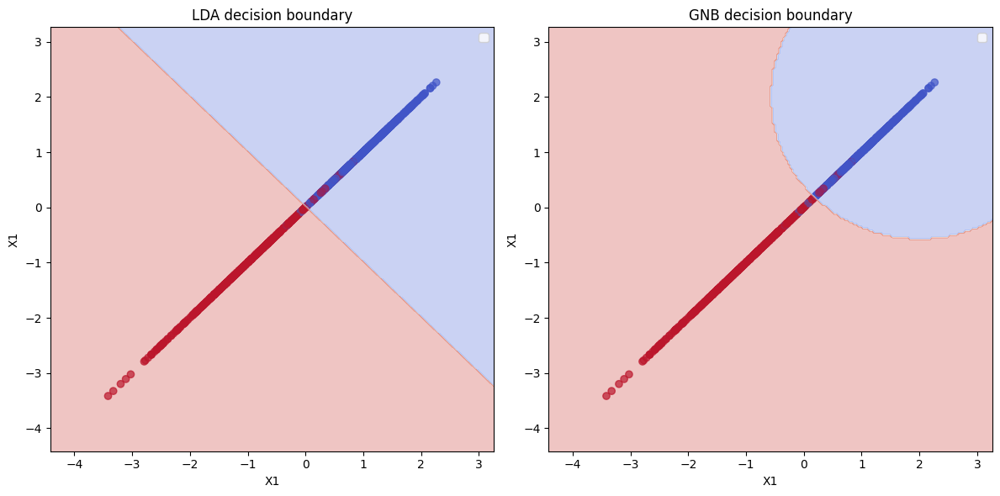

C:\Users\root\AppData\Local\Temp\ipykernel_21324\756218765.py:45: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend()
C:\Users\root\AppData\Local\Temp\ipykernel_21324\756218765.py:24: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend()


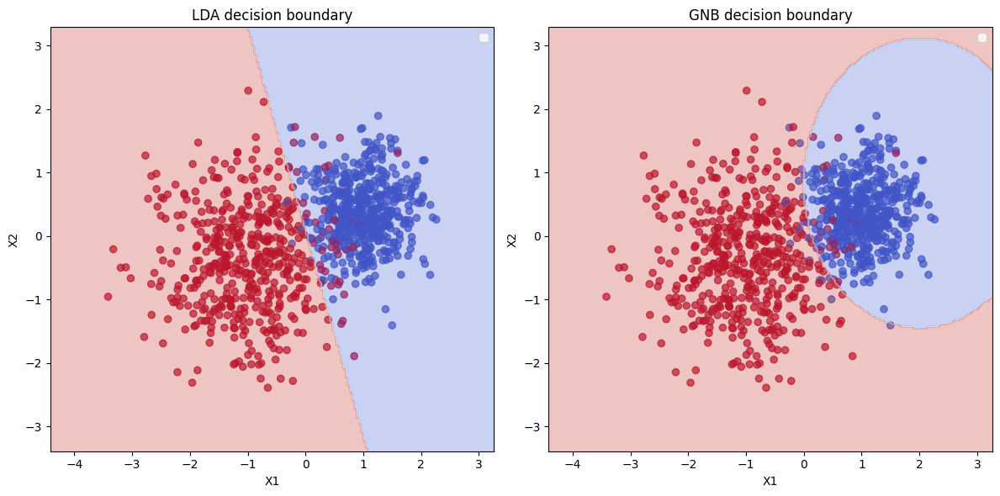

C:\Users\root\AppData\Local\Temp\ipykernel_21324\756218765.py:45: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend()
C:\Users\root\AppData\Local\Temp\ipykernel_21324\756218765.py:24: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend()


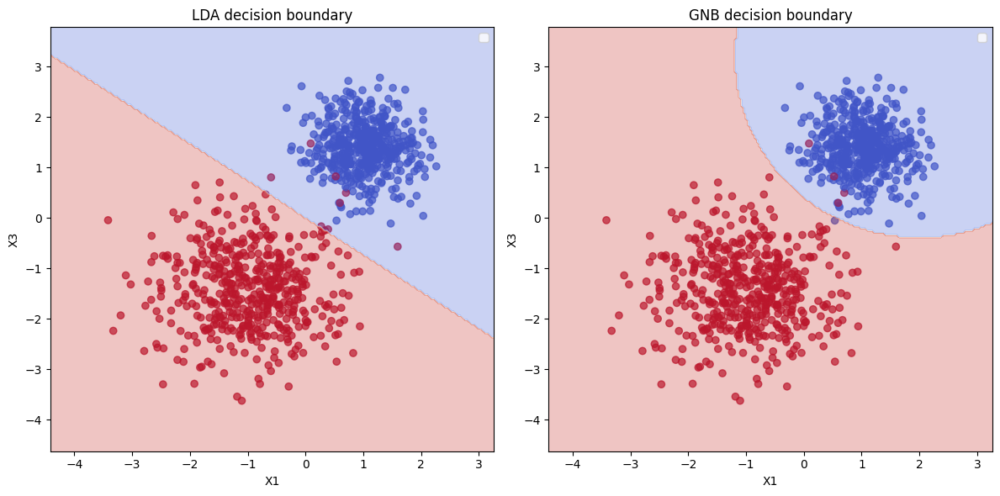

C:\Users\root\AppData\Local\Temp\ipykernel_21324\756218765.py:45: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend()
C:\Users\root\AppData\Local\Temp\ipykernel_21324\756218765.py:24: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend()


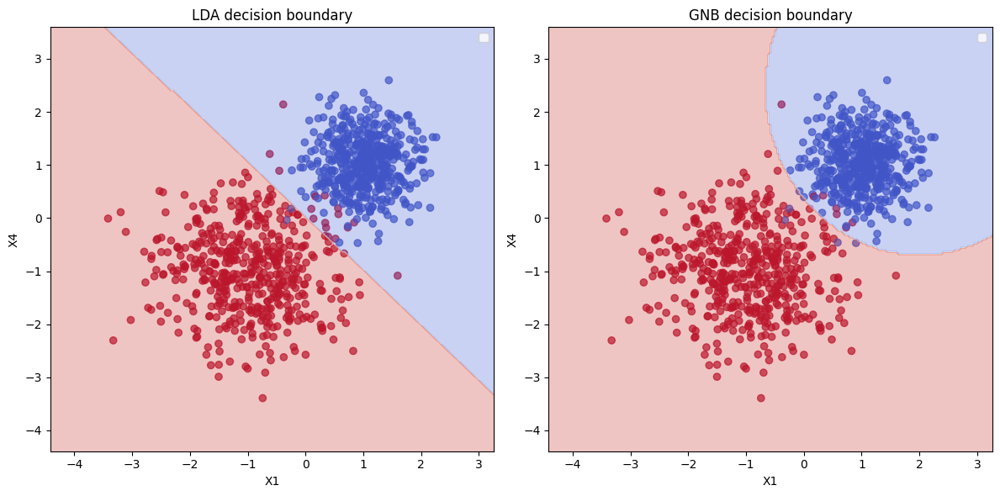

C:\Users\root\AppData\Local\Temp\ipykernel_21324\756218765.py:45: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend()
C:\Users\root\AppData\Local\Temp\ipykernel_21324\756218765.py:24: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend()


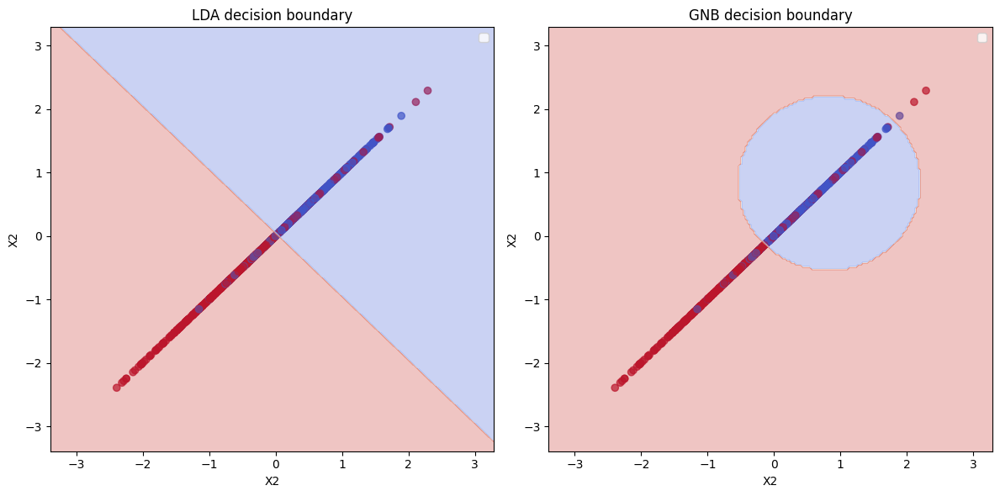

C:\Users\root\AppData\Local\Temp\ipykernel_21324\756218765.py:45: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend()
C:\Users\root\AppData\Local\Temp\ipykernel_21324\756218765.py:24: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend()


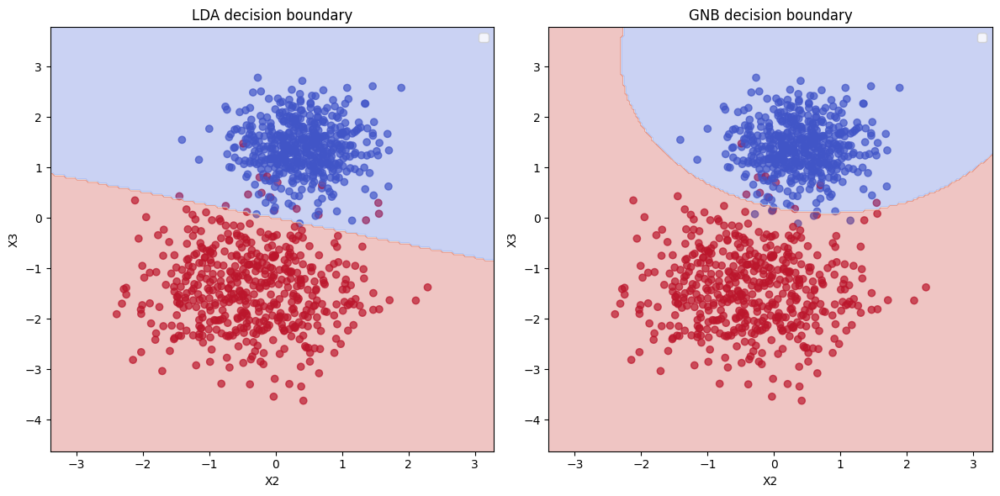

C:\Users\root\AppData\Local\Temp\ipykernel_21324\756218765.py:45: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend()
C:\Users\root\AppData\Local\Temp\ipykernel_21324\756218765.py:24: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend()


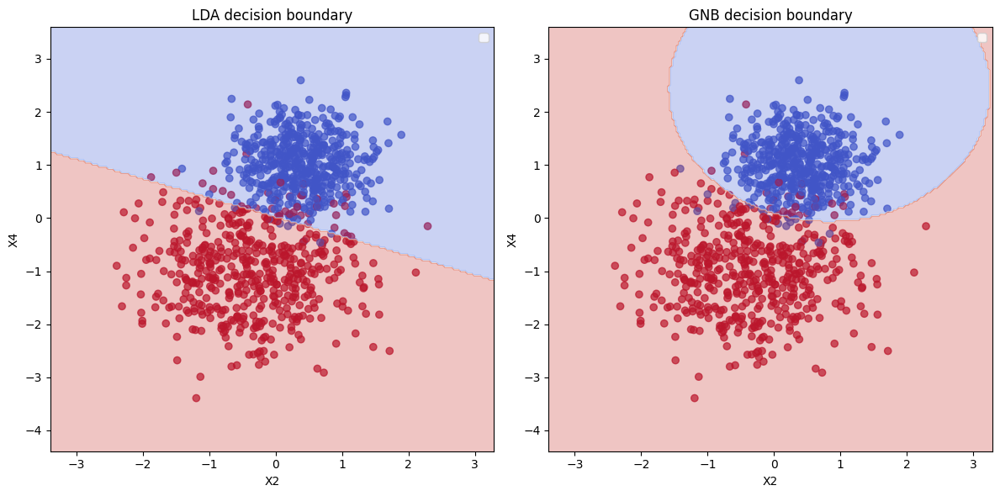

C:\Users\root\AppData\Local\Temp\ipykernel_21324\756218765.py:45: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend()
C:\Users\root\AppData\Local\Temp\ipykernel_21324\756218765.py:24: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend()


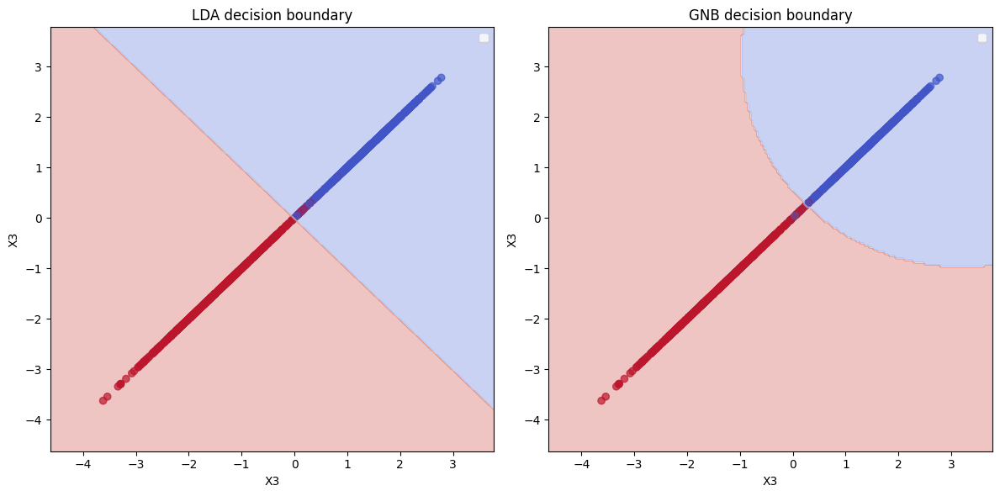

C:\Users\root\AppData\Local\Temp\ipykernel_21324\756218765.py:45: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend()
C:\Users\root\AppData\Local\Temp\ipykernel_21324\756218765.py:24: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend()


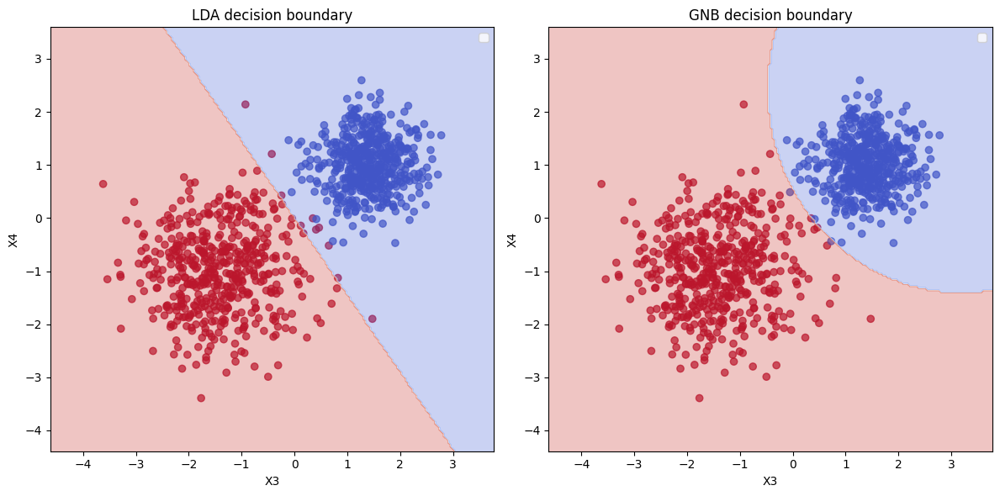

C:\Users\root\AppData\Local\Temp\ipykernel_21324\756218765.py:45: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend()
C:\Users\root\AppData\Local\Temp\ipykernel_21324\756218765.py:24: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend()


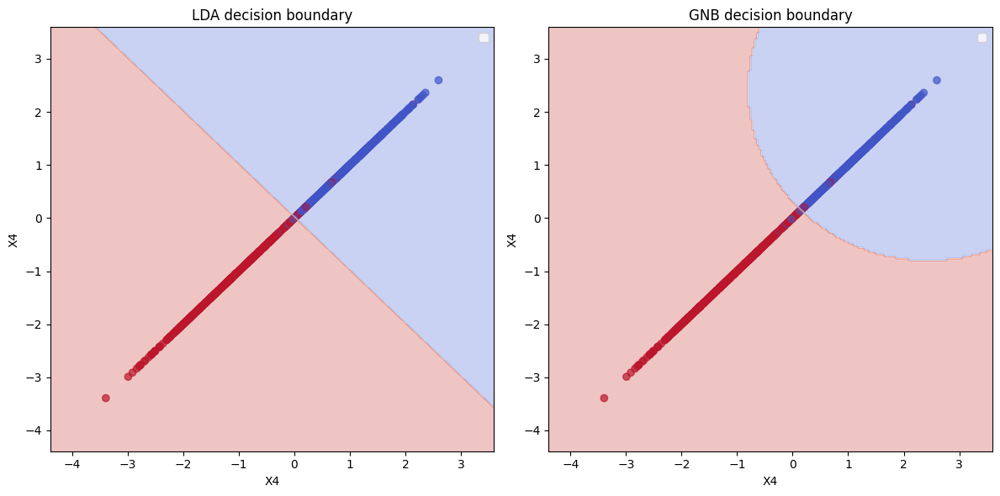

In [23]:
labels = ['X1', 'X2', 'X3', 'X4']

combinations = itertools.combinations_with_replacement(labels, 2)

for first, second in combinations:
    fig, ax = plt.subplots(1, 2, figsize=(12, 6))
    plot_nb_boundary(rotated_datasets[30], [first, second], ax[1])
    plot_lda_boundary(rotated_datasets[30], [first, second], ax[0])
    
    plt.tight_layout()
    plt.show()

In [28]:
import pandas as pd

playboy = pd.read_excel("./data/playboy-stats.xlsx")
playboy.head()

,Decade,Year,Issue,Model,aka,Ethnicity,Shown,Unnamed: 7,Playmate of the Year?,Eye \nColor,...,Bust \n(in),Waist \n(in),Hips \n(in),Height \n(in),Height \n(m),Weight \n(lbs),Weight \n(Kg),BMI,USA,Place of Birth
0,1950,1953,1953-12-01,Marilyn Monroe,NaN,Caucasian,Topless,NaN,No,Blue,...,36.0,24.0,34.0,65.0,1.6510,118.0,53.523856,19.636010,Y,"Los Angeles, California, United States"
1,1950,1954,1954-01-01,Margie Harrison,NaN,Caucasian,NaN,NaN,No,NaN,...,36.0,26.0,37.0,65.0,1.6510,100.0,45.359200,16.640687,Y,United States
2,1950,1954,1954-02-01,Margaret Scott,Marilyn Waltz,Caucasian,NaN,NaN,No,NaN,...,36.0,23.0,34.0,64.0,1.6256,113.0,51.255896,19.396191,Y,"Waukesha, Wisconsin, United States"
3,1950,1954,1954-03-01,Dolores del Monte,NaN,Caucasian,NaN,NaN,No,NaN,...,34.0,24.0,35.0,66.0,1.6764,118.0,53.523856,19.045487,Y,"Spokane, Washington, United States"
4,1950,1954,1954-04-01,Margaret Scott,Marilyn Waltz,Caucasian,NaN,NaN,No,NaN,...,36.0,23.0,34.0,64.0,1.6256,113.0,51.255896,19.396191,Y,"Waukesha, Wisconsin, United States"


In [27]:
labels = list(playboy)
print(labels)

['Decade', 'Year', 'Issue', 'Model', 'aka', 'Ethnicity', 'Shown', 'Unnamed: 7', 'Playmate of the Year?', 'Eye \nColor', 'Hair \nColor', 'Birthdate', 'Age', 'Bra \nSize', 'Cup\nValue', 'Cup \nSize', 'Bust \n(in)', 'Waist \n(in)', 'Hips \n(in)', 'Height \n(in)', 'Height \n(m)', 'Weight \n(lbs)', 'Weight \n(Kg)', 'BMI', 'USA', 'Place of Birth']


In [46]:
labels = ['Hair \nColor', 'Age','Year','Height \n(m)','Weight \n(Kg)','BMI','Bust \n(in)','Waist \n(in)','Hips \n(in)','Cup\nValue','USA']
boy = pd.DataFrame(playboy[labels])

In [47]:
from sklearn.preprocessing import LabelEncoder

label_encoder = LabelEncoder()

for column in boy.select_dtypes(include=['object']).columns:
    boy[column] = label_encoder.fit_transform(boy[column])

In [48]:
print(boy.dtypes)

# Separate datetime columns
datetime_columns = boy.select_dtypes(include=['datetime64']).columns
numeric_columns = boy.select_dtypes(exclude=['datetime64']).columns

# Imputation only on numeric columns
numeric_df = boy[numeric_columns]

# Apply imputations on numeric columns
simple_imputer = SimpleImputer(strategy='mean')
numeric_df_simple_imputed = pd.DataFrame(
    simple_imputer.fit_transform(numeric_df),
    columns=numeric_columns
)

# Recombine the DataFrame
final_df = pd.concat([numeric_df_simple_imputed, boy[datetime_columns]], axis=1)

print(final_df)
print(final_df.dtypes)

Hair \nColor       int32
Age                int64
Year               int64
Height \n(m)     float64
Weight \n(Kg)    float64
BMI              float64
Bust \n(in)      float64
Waist \n(in)     float64
Hips \n(in)      float64
Cup\nValue       float64
USA                int32
dtype: object
     Hair \nColor   Age    Year  Height \n(m)  Weight \n(Kg)        BMI  \
0             0.0  27.0  1953.0        1.6510      53.523856  19.636010   
1             1.0  23.0  1954.0        1.6510      45.359200  16.640687   
2             0.0  23.0  1954.0        1.6256      51.255896  19.396191   
3             1.0  22.0  1954.0        1.6764      53.523856  19.045487   
4             0.0  23.0  1954.0        1.6256      51.255896  19.396191   
..            ...   ...     ...           ...            ...        ...   
743           1.0  23.0  2015.0        1.6510      53.070264  19.469603   
744           1.0  21.0  2015.0        1.7526      58.966960  19.197431   
745           1.0  27.0  2015.0     

(748, 11) 
 Num of features 11
  Missing percentage: Hair \nColor     0.0
Age              0.0
Year             0.0
Height \n(m)     0.0
Weight \n(Kg)    0.0
BMI              0.0
Bust \n(in)      0.0
Waist \n(in)     0.0
Hips \n(in)      0.0
Cup\nValue       0.0
USA              0.0
dtype: float64
        Hair \nColor         Age         Year  Height \n(m)  Weight \n(Kg)  \
count    748.000000  748.000000   748.000000    748.000000     748.000000   
mean       0.584225   22.606952  1984.390374      1.680801      52.247776   
std        0.589618    2.814774    17.803028      0.057220       3.975919   
min        0.000000   17.000000  1953.000000      1.498600      38.555320   
25%        0.000000   21.000000  1969.000000      1.651000      49.895120   
50%        1.000000   22.000000  1984.500000      1.676400      52.163080   
75%        1.000000   24.000000  2000.000000      1.727200      54.431040   
max        2.000000   36.000000  2015.000000      1.879600      68.038800   

      

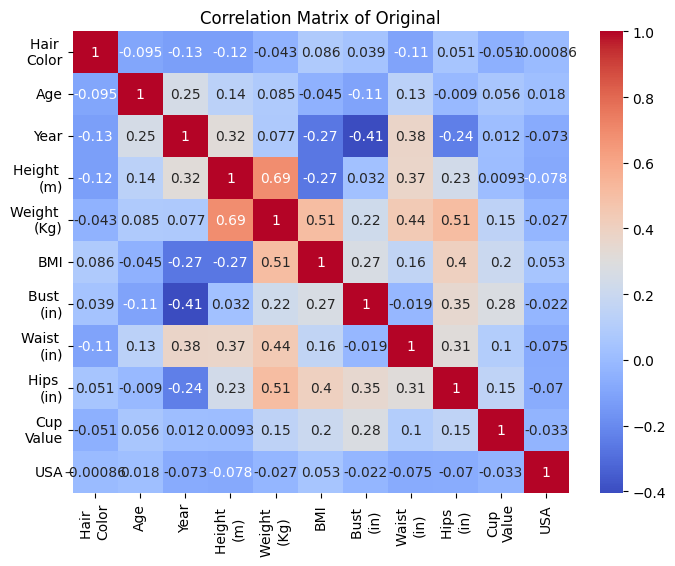

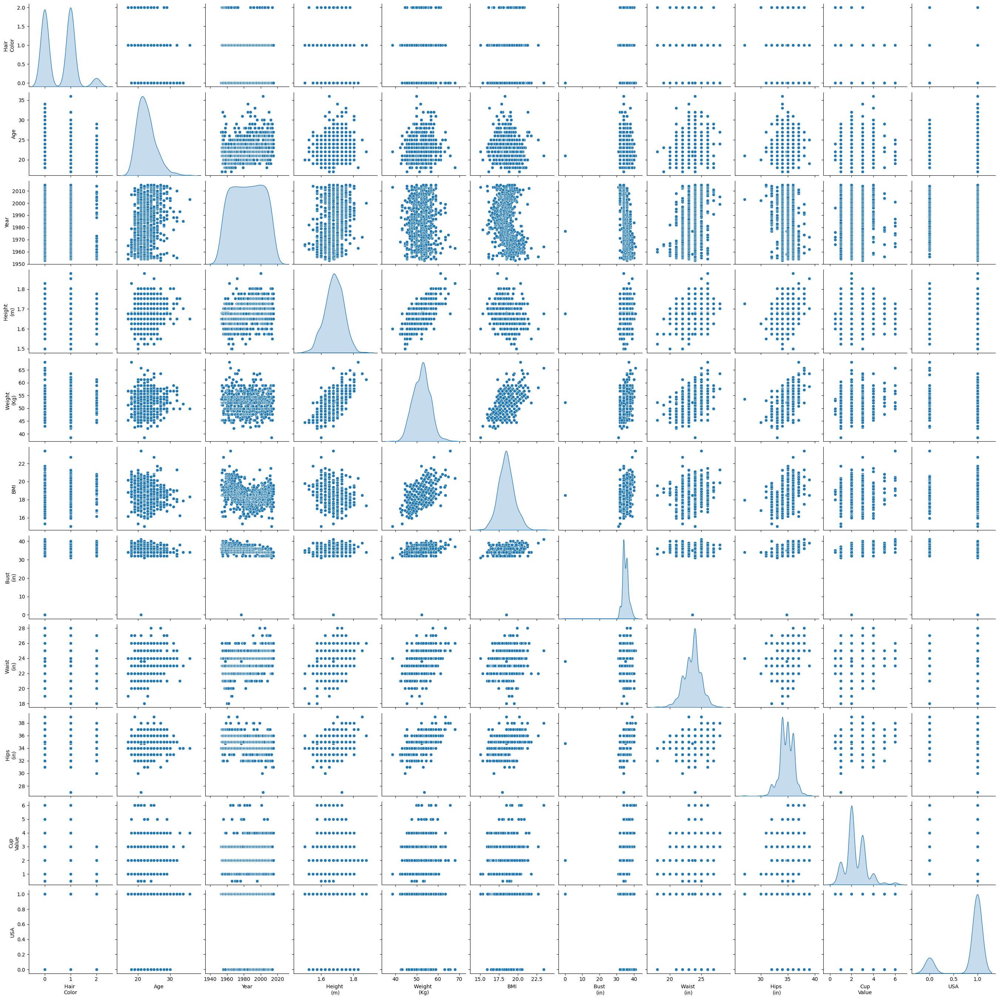

(748, 11) 
 Num of features 11
  Missing percentage: Hair \nColor     0.0
Age              0.0
Year             0.0
Height \n(m)     0.0
Weight \n(Kg)    0.0
BMI              0.0
Bust \n(in)      0.0
Waist \n(in)     0.0
Hips \n(in)      0.0
Cup\nValue       0.0
USA              0.0
dtype: float64
        Hair \nColor         Age         Year  Height \n(m)  Weight \n(Kg)  \
count    748.000000  748.000000   748.000000    748.000000     748.000000   
mean       0.584225   22.606952  1984.390374      1.680801      52.247776   
std        0.589618    2.814774    17.803028      0.057220       3.975919   
min        0.000000   17.000000  1953.000000      1.498600      38.555320   
25%        0.000000   21.000000  1969.000000      1.651000      49.895120   
50%        1.000000   22.000000  1984.500000      1.676400      52.163080   
75%        1.000000   24.000000  2000.000000      1.727200      54.431040   
max        2.000000   36.000000  2015.000000      1.879600      68.038800   

      

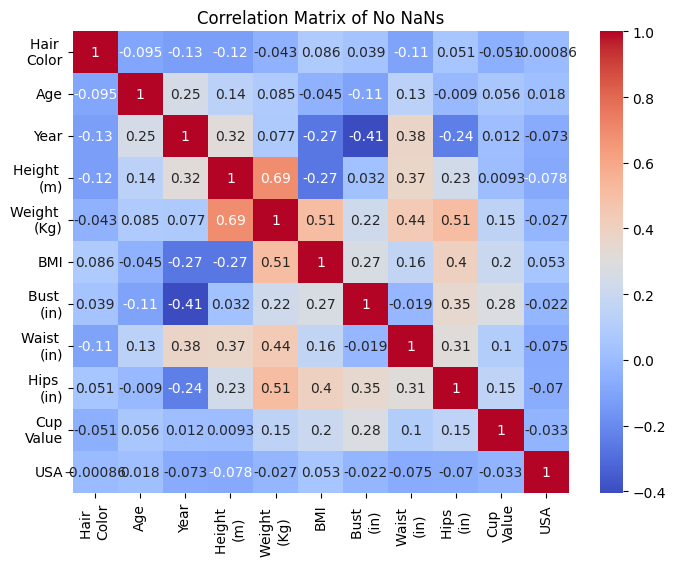

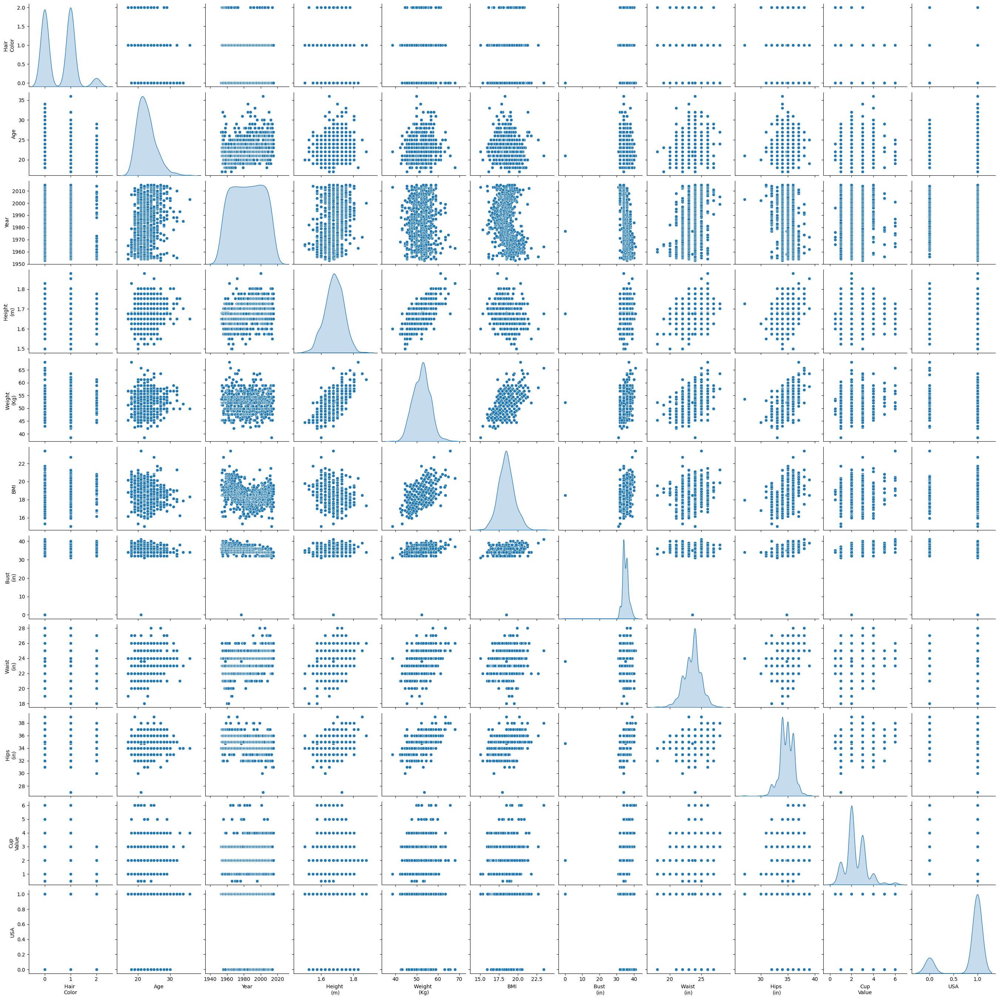

(748, 11) 
 Num of features 11
  Missing percentage: Hair \nColor     0.0
Age              0.0
Year             0.0
Height \n(m)     0.0
Weight \n(Kg)    0.0
BMI              0.0
Bust \n(in)      0.0
Waist \n(in)     0.0
Hips \n(in)      0.0
Cup\nValue       0.0
USA              0.0
dtype: float64
        Hair \nColor         Age         Year  Height \n(m)  Weight \n(Kg)  \
count    748.000000  748.000000   748.000000    748.000000     748.000000   
mean       0.584225   22.606952  1984.390374      1.680801      52.247776   
std        0.589618    2.814774    17.803028      0.057220       3.975919   
min        0.000000   17.000000  1953.000000      1.498600      38.555320   
25%        0.000000   21.000000  1969.000000      1.651000      49.895120   
50%        1.000000   22.000000  1984.500000      1.676400      52.163080   
75%        1.000000   24.000000  2000.000000      1.727200      54.431040   
max        2.000000   36.000000  2015.000000      1.879600      68.038800   

      

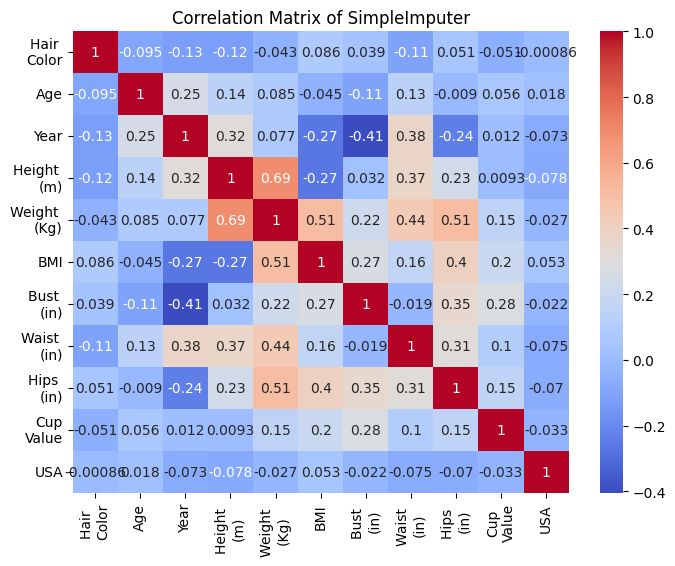

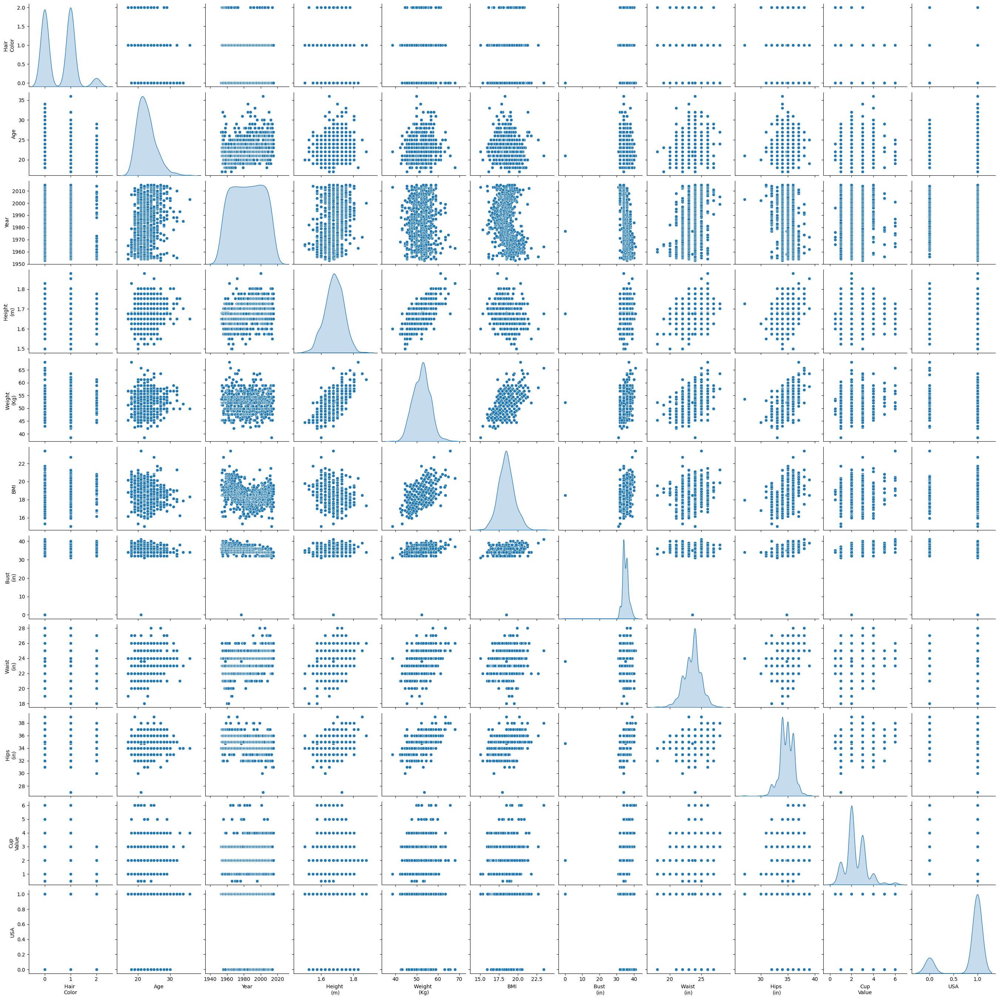

(748, 11) 
 Num of features 11
  Missing percentage: Hair \nColor     0.0
Age              0.0
Year             0.0
Height \n(m)     0.0
Weight \n(Kg)    0.0
BMI              0.0
Bust \n(in)      0.0
Waist \n(in)     0.0
Hips \n(in)      0.0
Cup\nValue       0.0
USA              0.0
dtype: float64
        Hair \nColor         Age         Year  Height \n(m)  Weight \n(Kg)  \
count    748.000000  748.000000   748.000000    748.000000     748.000000   
mean       0.584225   22.606952  1984.390374      1.680801      52.247776   
std        0.589618    2.814774    17.803028      0.057220       3.975919   
min        0.000000   17.000000  1953.000000      1.498600      38.555320   
25%        0.000000   21.000000  1969.000000      1.651000      49.895120   
50%        1.000000   22.000000  1984.500000      1.676400      52.163080   
75%        1.000000   24.000000  2000.000000      1.727200      54.431040   
max        2.000000   36.000000  2015.000000      1.879600      68.038800   

      

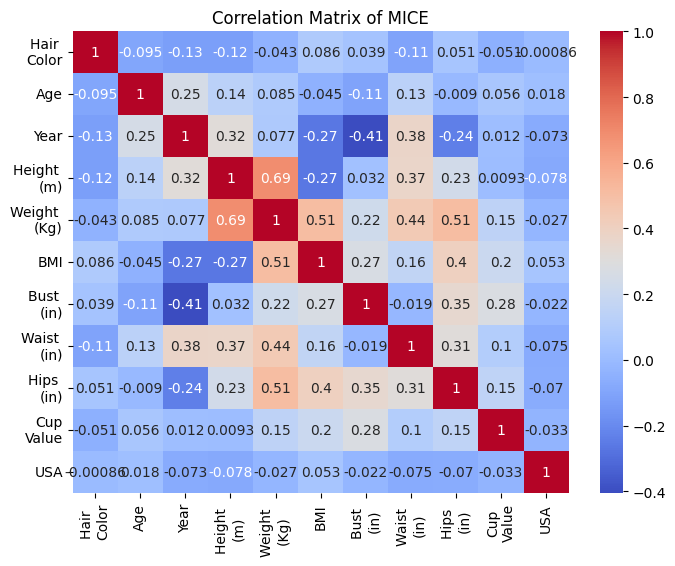

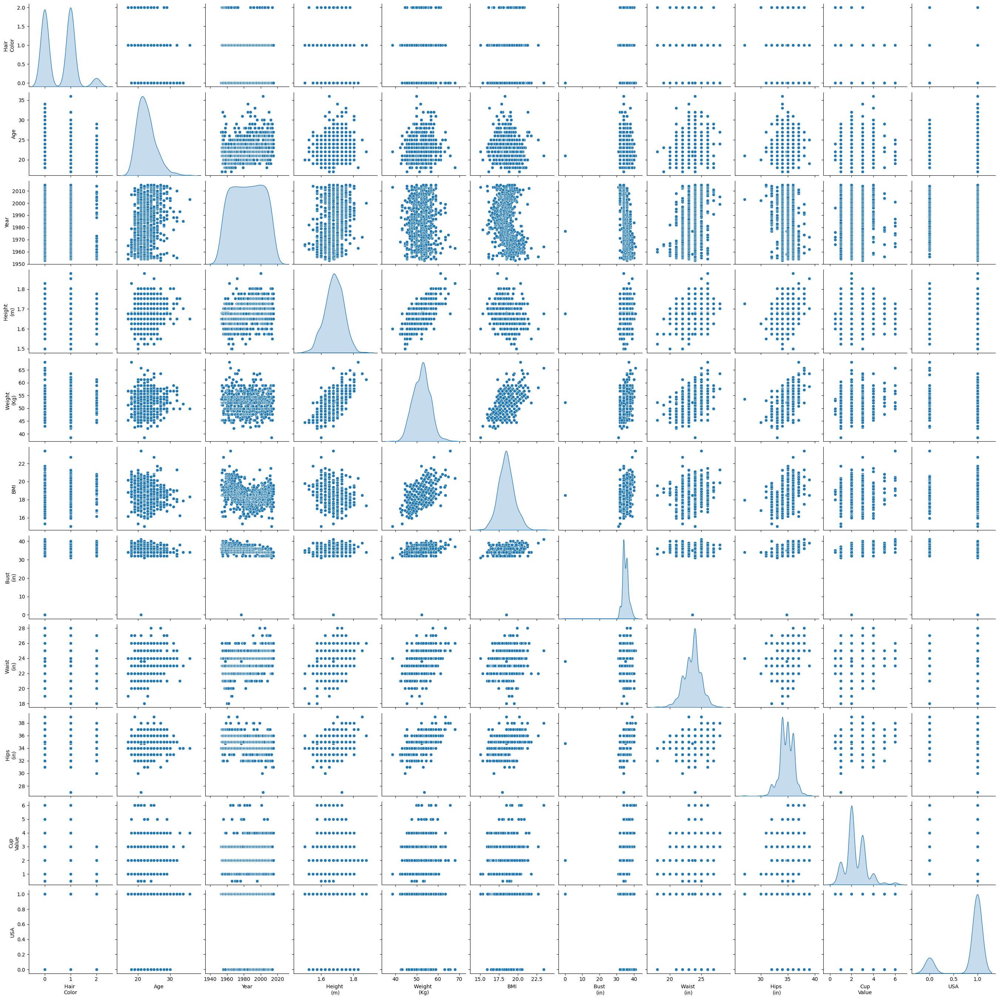

(748, 11) 
 Num of features 11
  Missing percentage: Hair \nColor     0.0
Age              0.0
Year             0.0
Height \n(m)     0.0
Weight \n(Kg)    0.0
BMI              0.0
Bust \n(in)      0.0
Waist \n(in)     0.0
Hips \n(in)      0.0
Cup\nValue       0.0
USA              0.0
dtype: float64
        Hair \nColor         Age         Year  Height \n(m)  Weight \n(Kg)  \
count    748.000000  748.000000   748.000000    748.000000     748.000000   
mean       0.584225   22.606952  1984.390374      1.680801      52.247776   
std        0.589618    2.814774    17.803028      0.057220       3.975919   
min        0.000000   17.000000  1953.000000      1.498600      38.555320   
25%        0.000000   21.000000  1969.000000      1.651000      49.895120   
50%        1.000000   22.000000  1984.500000      1.676400      52.163080   
75%        1.000000   24.000000  2000.000000      1.727200      54.431040   
max        2.000000   36.000000  2015.000000      1.879600      68.038800   

      

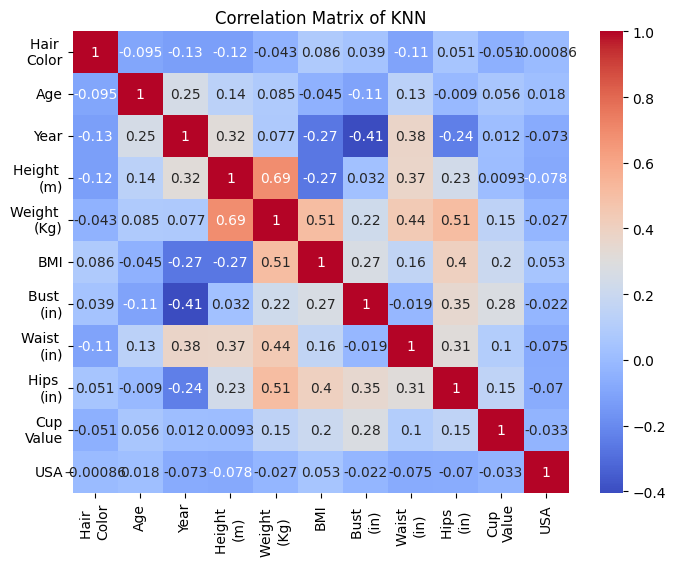

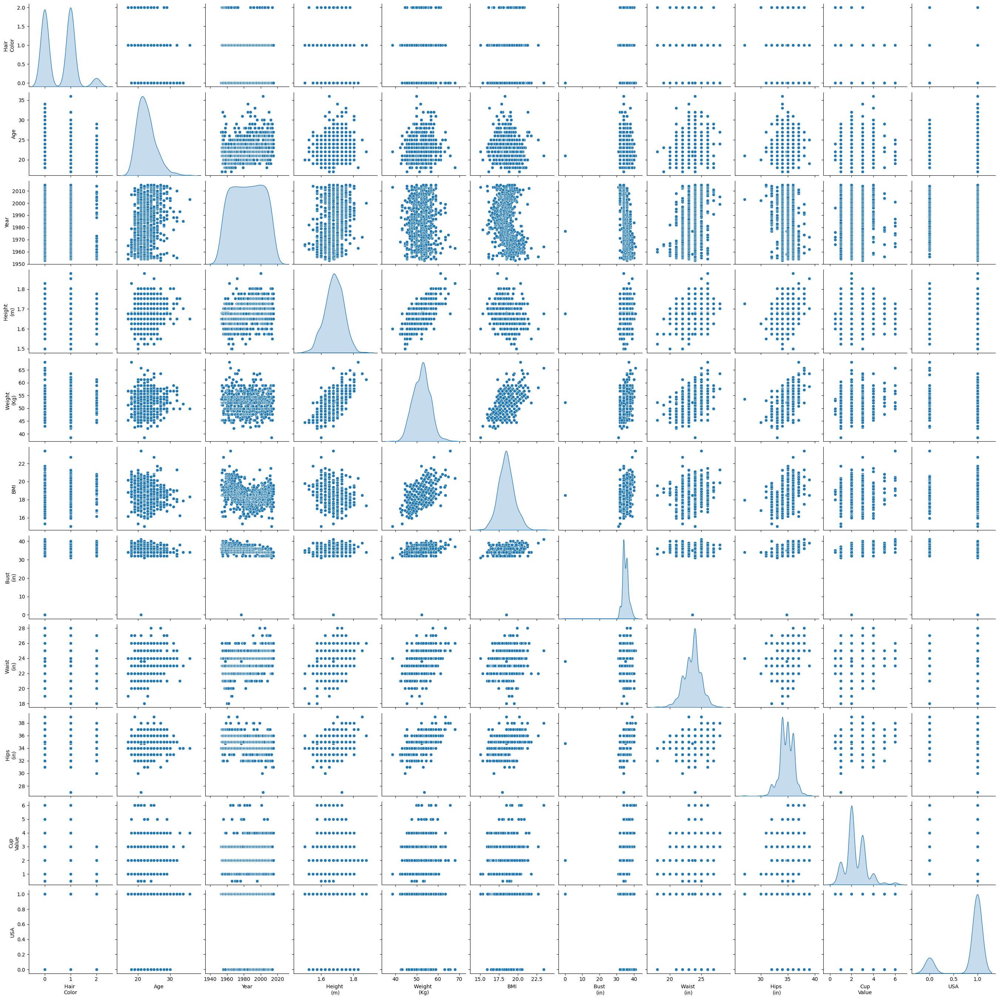

In [54]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.impute import SimpleImputer
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.impute import KNNImputer

df_no_nans = final_df.dropna()

# [6b] Заменяем NaN на среднее
simple_imputer = SimpleImputer(strategy='mean')
df_simple_imputed = pd.DataFrame(simple_imputer.fit_transform(final_df), columns=final_df.columns)

# [6c] Заменяем NaN с использованием MICE
mice_imputer = IterativeImputer(random_state=0)
df_mice_imputed = pd.DataFrame(mice_imputer.fit_transform(final_df), columns=final_df.columns)

# [6d] Заменяем NaN с использованием KNN
knn_imputer = KNNImputer(n_neighbors=2)
df_knn_imputed = pd.DataFrame(knn_imputer.fit_transform(final_df), columns=final_df.columns)

# Визуализация всех пар переменных
datasets = {
    "Original": final_df,
    "No NaNs": df_no_nans,
    "SimpleImputer": df_simple_imputed,
    "MICE": df_mice_imputed,
    "KNN": df_knn_imputed,
}

def show_plot(df, name):
    dataset_shape = df.shape
    num_features = df.shape[1]
    missing_percentage = df.isnull().mean() * 100
    description = df.describe()

    print(dataset_shape, '\n', f'Num of features {num_features}\n',
      f' Missing percentage: {missing_percentage}\n', description)
    correlation_matrix = df.corr()
    plt.figure(figsize=(8, 6))
    sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
    plt.title(f'Correlation Matrix of {name}')
    plt.show()
    sns.pairplot(df, diag_kind='kde')
    plt.show()
    
for name, dataset in datasets.items():
    show_plot(dataset, name)

In [67]:
from sklearn.manifold import TSNE
import numpy as np
import matplotlib.pyplot as plt
from sklearn.naive_bayes import GaussianNB
import statsmodels.api as sm

def plot_tsne_boundary_original_data(df, ax, ax_kde, tc='label'):
    # Исходные данные: разделение на признаки и целевую переменную
    X = df.drop(columns=tc).values
    y = df[tc].values
    
    # Обучение Gaussian Naive Bayes на исходных данных
    gnb = GaussianNB()
    gnb.fit(X, y)
    
    # Преобразование данных методом t-SNE для визуализации
    tsne = TSNE(n_components=2, random_state=42)
    X_embedded = tsne.fit_transform(X)
    
    # Визуализация t-SNE-преобразованных данных
    scatter = ax.scatter(X_embedded[:, 0], X_embedded[:, 1], c=y, cmap='coolwarm', alpha=0.7)
    ax.set_title("t-SNE Visualization with Decision Boundary")
    ax.set_xlabel("t-SNE Component 1")
    ax.set_ylabel("t-SNE Component 2")
    plt.colorbar(scatter, ax=ax, label=tc)
    
    # Создание сетки для отображения границы разделения
    x_min, x_max = X_embedded[:, 0].min() - 1, X_embedded[:, 0].max() + 1
    y_min, y_max = X_embedded[:, 1].min() - 1, X_embedded[:, 1].max() + 1
    xx, yy = np.meshgrid(np.linspace(x_min, x_max, 200), np.linspace(y_min, y_max, 200))
    grid_points = np.c_[xx.ravel(), yy.ravel()]
    
    # Приближение: расчет вероятностей напрямую в t-SNE пространстве
    Z = []
    for point in grid_points:
        # Найти ближайшие точки в t-SNE-преобразованном пространстве
        distances = np.linalg.norm(X_embedded - point, axis=1)
        nearest_index = np.argmin(distances)
        
        # Использовать соответствующую точку из исходного пространства
        nearest_original = X[nearest_index].reshape(1, -1)
        Z.append(gnb.predict_proba(nearest_original)[0, 1])
    
    Z = np.array(Z).reshape(xx.shape)
    
    # Построение границы разделения
    ax.contourf(xx, yy, Z, alpha=0.4, cmap='coolwarm', levels=50)
    
    # Kernel Density Estimation на t-SNE-преобразованных данных
    kde = sm.nonparametric.KDEMultivariate(data=[X_embedded[:, 0], X_embedded[:, 1]], var_type='cc')
    x = np.linspace(x_min, x_max, 100)
    y = np.linspace(y_min, y_max, 100)
    X, Y = np.meshgrid(x, y)
    positions = np.vstack([X.ravel(), Y.ravel()])
    Z_kde = kde.pdf(positions.T).reshape(X.shape)
    
    # Построение KDE
    ax_kde.contourf(X, Y, Z_kde, cmap='viridis')
    ax_kde.set_title("2D Kernel Density Estimation")
    ax_kde.set_xlabel("t-SNE Component 1")
    ax_kde.set_ylabel("t-SNE Component 2")

In [75]:
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import roc_curve, auc
from sklearn.naive_bayes import GaussianNB
import numpy as np

def plot_multiclass_roc_ci(df, name, ax, n_bootstraps=1000, ci=95, tc='label'):
    # Extract classes and initialize variables
    classes = df[tc].unique()
    n_classes = len(classes)
    y = df[tc].values
    X = df.drop(columns=tc).values

    roc_fpr_array = np.linspace(0, 1, 100)  # Common FPR grid
    roc_tpr_arrays = {cls: [] for cls in range(n_classes)}
    y_real, y_proba = [], []

    # Stratified K-Fold Cross-Validation
    skf = StratifiedKFold(n_splits=5)
    for train_index, test_index in skf.split(X, y):
        X_train, X_test = X[train_index], X[test_index]
        y_train, y_test = y[train_index], y[test_index]

        # Train the classifier
        predictor = GaussianNB()
        predictor.fit(X_train, y_train)
        y_proba_fold = predictor.predict_proba(X_test)
        
        y_real.append(y_test)
        y_proba.append(y_proba_fold)

        # Calculate ROC curve for each class
        for i in range(n_classes):
            # Binarize the true labels for the current class
            y_test_bin = (y_test == classes[i]).astype(int)
            fpr, tpr, _ = roc_curve(y_test_bin, y_proba_fold[:, i])
            roc_tpr_interp = np.interp(roc_fpr_array, fpr, tpr)
            roc_tpr_interp[0] = 0.0
            roc_tpr_arrays[i].append(roc_tpr_interp)
    
    # Aggregate results for bootstrapping
    y_real = np.hstack(y_real)
    y_proba = np.vstack(y_proba)

    for i, cls in enumerate(classes):
        # Compute mean and std of TPR for confidence intervals
        mean_tpr = np.mean(roc_tpr_arrays[i], axis=0)
        std_tpr = np.std(roc_tpr_arrays[i], axis=0)
        ci_lower = np.maximum(mean_tpr - 1.96 * std_tpr, 0)
        ci_upper = np.minimum(mean_tpr + 1.96 * std_tpr, 1)

        # Compute overall ROC curve
        y_real_bin = (y_real == cls).astype(int)
        fpr, tpr, thresholds = roc_curve(y_real_bin, y_proba[:, i])
        roc_auc = auc(fpr, tpr)

        # Plot the ROC curve
        ax.plot(fpr, tpr, label=f"Class {cls} (AUROC = {roc_auc:.4f})", lw=2)
        ax.fill_between(roc_fpr_array, ci_lower, ci_upper, alpha=0.2, label=f"Class {cls} 95% CI")

        # Highlight threshold = 0.5
        threshold_idx = np.argmin(np.abs(thresholds - 0.5))
        ax.plot(fpr[threshold_idx], tpr[threshold_idx], 'o', markersize=8, label=f"Class {cls} Threshold=0.5", alpha=0.6)

    # Formatting
    ax.set_title(f"Multiclass ROC with {ci}% CI - {name}", weight="bold", fontsize=15)
    ax.set_xlabel("False Positive Rate", fontsize=12)
    ax.set_ylabel("True Positive Rate", fontsize=12)
    ax.legend(loc='lower right', fontsize='small')

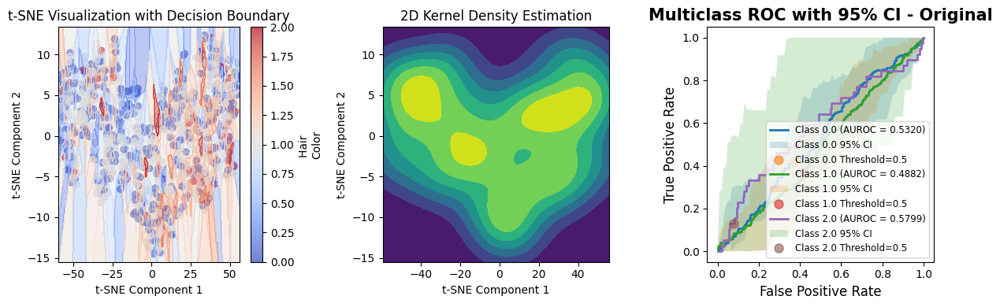

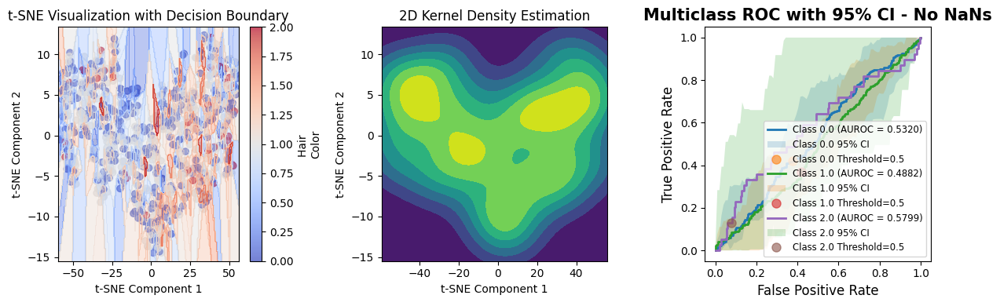

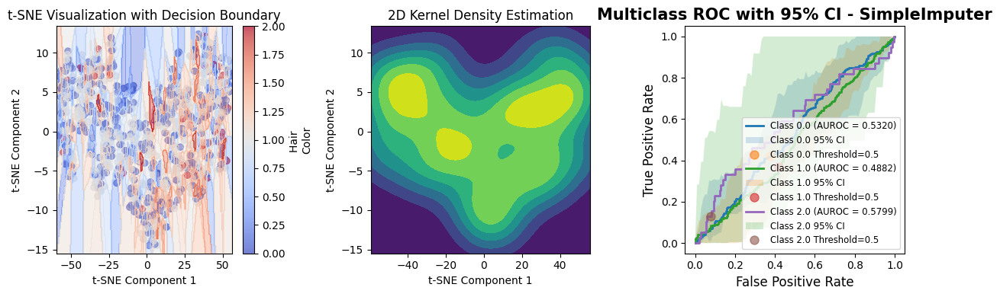

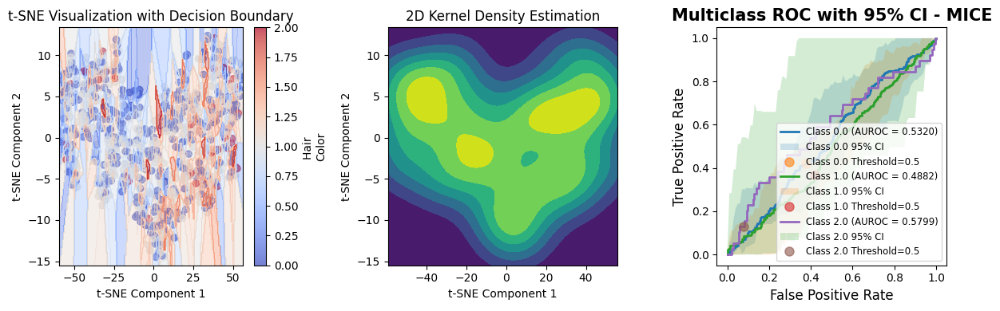

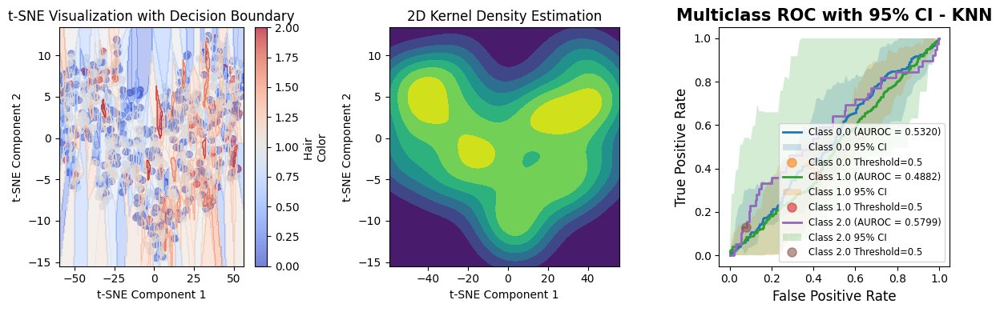

In [76]:
for name, dataset in datasets.items():
    fig, ax = plt.subplots(1, 3, figsize=(12, 4))
    plot_tsne_boundary_original_data(dataset, ax[0], ax[1], tc='Hair \nColor')
    plot_multiclass_roc_ci(dataset, name, ax[2], n_bootstraps=1000, ci=95, tc='Hair \nColor')
    plt.tight_layout()
    plt.show()

In [95]:
def plot_boundary_multiclass(df, name, ax, ax_kde, sc, tc='label'):
    import statsmodels.api as sm
    from sklearn.naive_bayes import GaussianNB
    import numpy as np
    import matplotlib.pyplot as plt
    from matplotlib.colors import ListedColormap

    # Extract the feature (X) and target (y)
    X = df[sc].values.reshape(-1, 1)  # Single feature, reshaped for compatibility
    y = df[tc].values
    classes = np.unique(y)

    # Train Gaussian Naive Bayes
    gnb = GaussianNB()
    gnb.fit(X, y)

    # Create a range of values for X to plot the decision boundaries
    x_range = np.linspace(X.min() - 1, X.max() + 1, 500).reshape(-1, 1)

    # Predict class probabilities and determine the predicted class
    predicted_classes = gnb.predict(x_range)

    # Create a colormap for the classes
    colors = plt.cm.tab10(np.linspace(0, 1, len(classes)))
    cmap = ListedColormap(colors)

    # Plot the predicted classes as a background
    for i, cls in enumerate(classes):
        mask = predicted_classes == cls
        ax.scatter(
            x_range[mask],
            np.full_like(x_range[mask], cls),
            c=colors[i].reshape(1, -1),
            s=5,
            alpha=0.5,
            label=f"Predicted Class {cls}" if i == 0 else None,
        )

    # Overlay actual data points with ground truth labels
    scatter = ax.scatter(
        X.ravel(),
        y,
        c=y,
        cmap=cmap,
        edgecolor='k',
        label="Ground Truth",
        alpha=0.7,
    )

    # Find thresholds for each class
    class_means = gnb.theta_.flatten()  # Mean of each class
    sorted_means = np.sort(class_means)  # Sort to draw vertical lines in order

    for mean, cls in zip(sorted_means, classes):
        ax.axvline(mean, color='black', linestyle='--', lw=1.5, alpha=0.7, label=f"Class {cls} Threshold")

    # Set titles and labels
    ax.set_title(f"Decision Boundaries with Ground Truth for {name}")
    ax.set_xlabel(sc)
    ax.set_ylabel(tc)

    # Kernel Density Estimation for the feature
    kde = sm.nonparametric.KDEUnivariate(X.ravel())
    kde.fit()

    # Generate density values
    density_x = np.linspace(X.min() - 1, X.max() + 1, 500)
    density_y = kde.evaluate(density_x)

    # Plot KDE on a separate subplot
    ax_kde.plot(density_x, density_y, color='blue', lw=2)
    ax_kde.set_title(f"Kernel Density Estimation for {sc}")
    ax_kde.set_xlabel(sc)
    ax_kde.set_ylabel("Density")

    # Add legends
    ax.legend(loc="upper right")
    plt.colorbar(scatter, ax=ax, label=tc)

    plt.tight_layout()


In [96]:
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import roc_curve, auc
from sklearn.naive_bayes import GaussianNB
import numpy as np

def plot_sc_roc_ci(df, name, ax, sc, n_bootstraps=1000, ci=95, tc='label'):
    # Extract classes and initialize variables
    classes = df[tc].unique()
    n_classes = len(classes)
    y = df[tc].values
    X = df[sc].values
    X = X.reshape(-1, 1)

    roc_fpr_array = np.linspace(0, 1, 100)  # Common FPR grid
    roc_tpr_arrays = {cls: [] for cls in range(n_classes)}
    y_real, y_proba = [], []

    # Stratified K-Fold Cross-Validation
    skf = StratifiedKFold(n_splits=5)
    for train_index, test_index in skf.split(X, y):
        X_train, X_test = X[train_index], X[test_index]
        y_train, y_test = y[train_index], y[test_index]

        # Train the classifier
        predictor = GaussianNB()
        predictor.fit(X_train, y_train)
        y_proba_fold = predictor.predict_proba(X_test)
        
        y_real.append(y_test)
        y_proba.append(y_proba_fold)

        # Calculate ROC curve for each class
        for i in range(n_classes):
            # Binarize the true labels for the current class
            y_test_bin = (y_test == classes[i]).astype(int)
            fpr, tpr, _ = roc_curve(y_test_bin, y_proba_fold[:, i])
            roc_tpr_interp = np.interp(roc_fpr_array, fpr, tpr)
            roc_tpr_interp[0] = 0.0
            roc_tpr_arrays[i].append(roc_tpr_interp)
    
    # Aggregate results for bootstrapping
    y_real = np.hstack(y_real)
    y_proba = np.vstack(y_proba)

    for i, cls in enumerate(classes):
        # Compute mean and std of TPR for confidence intervals
        mean_tpr = np.mean(roc_tpr_arrays[i], axis=0)
        std_tpr = np.std(roc_tpr_arrays[i], axis=0)
        ci_lower = np.maximum(mean_tpr - 1.96 * std_tpr, 0)
        ci_upper = np.minimum(mean_tpr + 1.96 * std_tpr, 1)

        # Compute overall ROC curve
        y_real_bin = (y_real == cls).astype(int)
        fpr, tpr, thresholds = roc_curve(y_real_bin, y_proba[:, i])
        roc_auc = auc(fpr, tpr)

        # Plot the ROC curve
        ax.plot(fpr, tpr, label=f"Class {cls} (AUROC = {roc_auc:.4f})", lw=2)
        ax.fill_between(roc_fpr_array, ci_lower, ci_upper, alpha=0.2, label=f"Class {cls} 95% CI")

        # Highlight threshold = 0.5
        threshold_idx = np.argmin(np.abs(thresholds - 0.5))
        ax.plot(fpr[threshold_idx], tpr[threshold_idx], 'o', markersize=8, label=f"Class {cls} Threshold=0.5", alpha=0.6)

    # Formatting
    ax.set_title(f"Multiclass ROC with {ci}% CI - {name}")
    ax.set_xlabel("False Positive Rate", fontsize=12)
    ax.set_ylabel("True Positive Rate", fontsize=12)
    ax.legend(loc='lower right', fontsize='small')

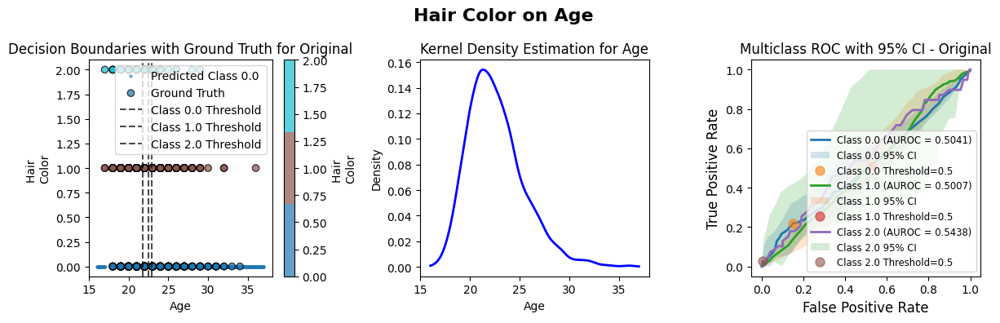

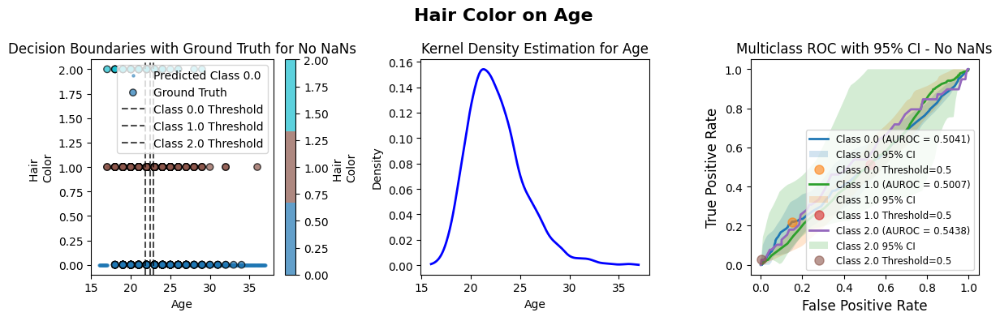

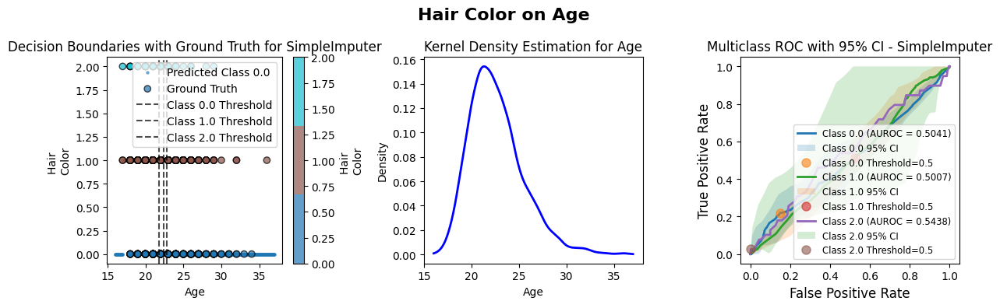

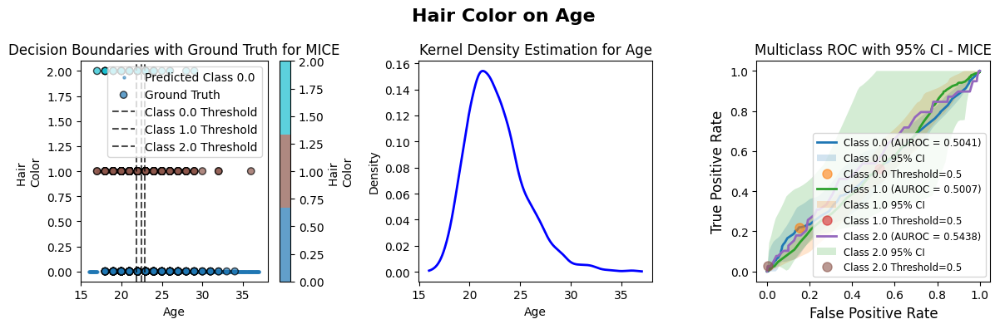

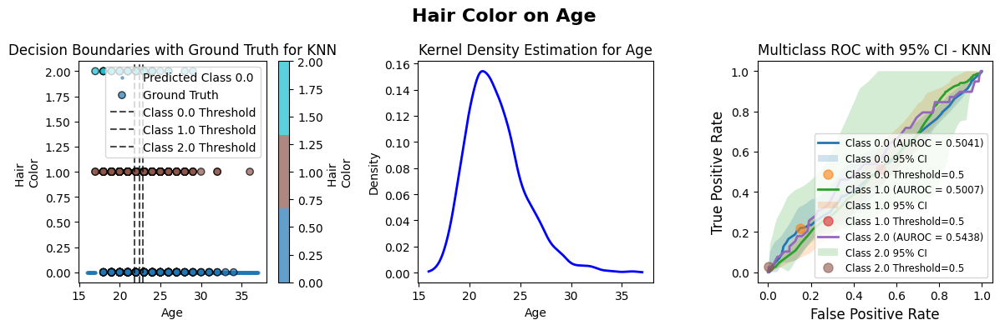

...

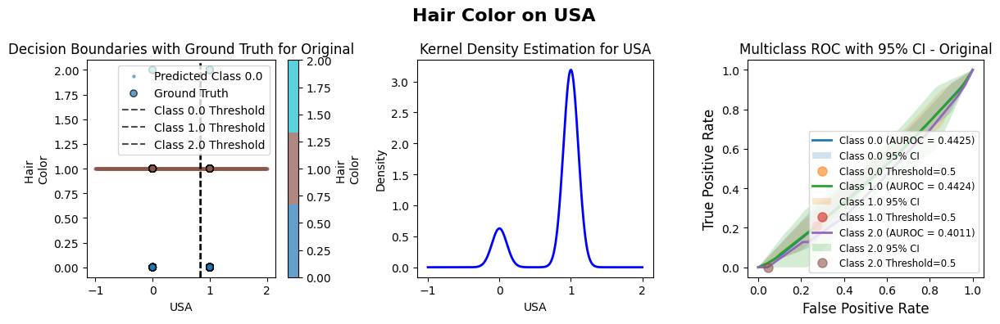

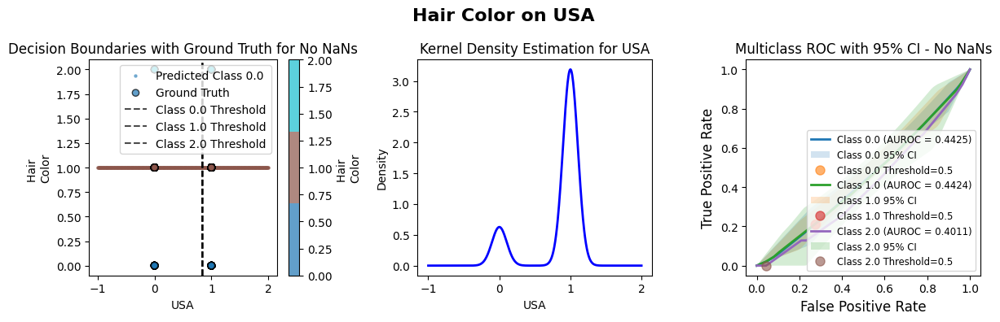

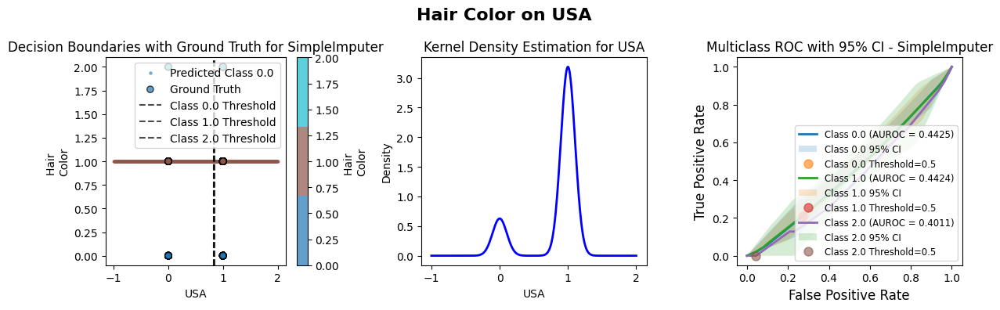

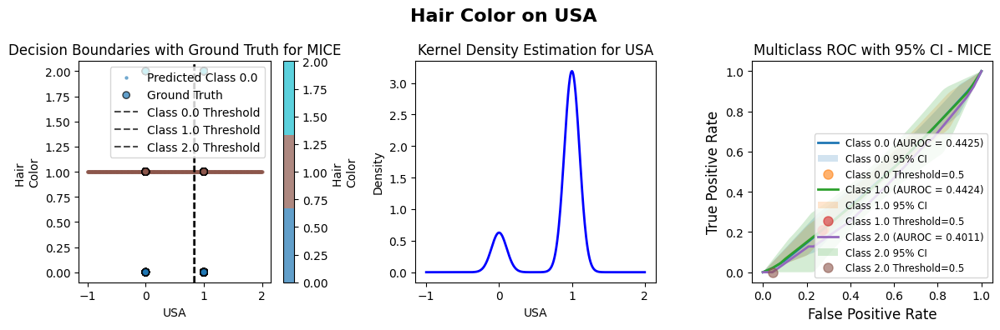

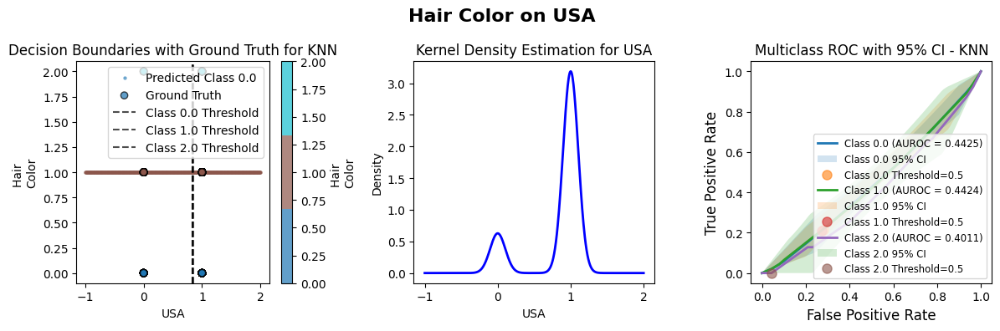

In [97]:
labels = ['Age','Year','Height \n(m)','Weight \n(Kg)','BMI','Bust \n(in)','Waist \n(in)','Hips \n(in)','Cup\nValue','USA']
for label in labels:
    for name, dataset in datasets.items():
        fig, ax = plt.subplots(1, 3, figsize=(12, 4))
        plot_boundary_multiclass(dataset, name, ax[0], ax[1], sc=label, tc='Hair \nColor')
        plot_sc_roc_ci(dataset, name, ax[2], label, n_bootstraps=1000, ci=95, tc='Hair \nColor')
        fig.suptitle(f"Hair Color on {label}", fontsize=16, weight="bold")
        plt.tight_layout()
        plt.show()